<h1 align=center><font size = 5>New York Food Venues Analysis</font></h1>

## Introduction

This project aims to analyze the food venues in New York City, in the basis of community board. The information of community boards, neighborhood, geometry and so on is fetched from wiki page and online geojson file. A set of bar plots, box plots and choropleth maps are generated according to the results of data cleaning and analyzing. In the final, K-means cluster analysis is performed in terms of food category's rating and pupularity.

Tools used: Python, Scikit-learn, NumPy, Pandas, Scipy, Branca, Shapely, Matplotlib, Folium

import all the dependencies that are needed

In [766]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

# import scipy for correlation test and distance calculation
from scipy.stats import pearsonr
from scipy.spatial.distance import cdist

# import k-means from clustering stage
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library
from folium.plugins import Search

import branca
import geopandas

#for processing MultiPolygon and Polygon from geojson
from shapely.geometry import MultiPolygon, Polygon, Point

print('Libraries imported.')
print(folium.__version__)

Libraries imported.
0.11.0


In [151]:
# import urllib.request and BeautifulSoup for fetching the table
import urllib.request
from bs4 import BeautifulSoup

#### Scrape the Community Board Info in the Wikipedia Page

In [152]:
# create funcion to fetch the wiki page information

def get_wiki_table(url):
    page = urllib.request.urlopen(url)
    soup = BeautifulSoup(page, "lxml")
    all_tables=soup.find_all("table")
    right_table=soup.find('table', class_='wikitable')
    
    #table columns
    neighborhoods=[]
    community_boards=[]
    areas = []
    pops = []
    pop_km2 = []
    
    #Loop through the rows of the table
    for row in right_table.findAll('tr'):
        cells=row.findAll('td')
        if len(cells) == 5:
            community_boards.append(cells[0].find(text=True))
            areas.append(cells[1].find(text=True))
            pops.append(cells[2].find(text=True))
            pop_km2.append(cells[3].find(text=True))
            neighborhoods.append(cells[4].find_all(text=True))
    
    return community_boards, areas, pops, pop_km2, neighborhoods

In [153]:
# Specify the URL of the Wikipedia page
url = 'https://en.wikipedia.org/wiki/Neighborhoods_in_New_York_City'

In [154]:
# store the column values from get_wiki_table(url)

community_boards = []
areas = []
pops = []
pop_km2 = []
neighborhoods = []

newyork = []

community_boards, areas, pops, pop_km2, neighborhoods = get_wiki_table(url)

In [155]:
# transform list to string

def listToString(s):  
    str1 = "" 
    return (str1.join(s)) 

In [156]:
# transform the list format of column values obtained to string
neighborhood_converts = [listToString(neighborhood) for neighborhood in neighborhoods]

# format the neighborhoods column
neighborhoods = [neighborhood_convert.rstrip('\n') for neighborhood_convert in neighborhood_converts]

In [157]:
# create the corresponding dataframe
newyork = pd.DataFrame(community_boards,columns=['Community Board'])
newyork['Area km$^2$'] = areas
newyork['Pop.'] = pops
newyork['Pop. /km$^2$'] = pop_km2
newyork['Neighborhood'] = neighborhoods

In [158]:
# delete the last row which contains 'new york' info
newyork.drop(index = len(neighborhoods) - 1, axis = 1, inplace = True)

In [159]:
newyork.head()

,Community Board,Area km$^2$,Pop.,Pop. /km$^2$,Neighborhood
0,Bronx CB 1,7.17,"91,497","12,761","Melrose, Mott Haven, Port Morris"
1,Bronx CB 2,5.54,"52,246","9,792","Hunts Point, Longwood"
2,Bronx CB 3,4.07,"79,762","19,598","Claremont, Concourse Village, Crotona Park, Mo..."
3,Bronx CB 4,5.28,"146,441","27,735","Concourse, Highbridge"
4,Bronx CB 5,3.55,"128,200","36,145","Fordham, Morris Heights, Mount Hope, Universit..."


In [160]:
# get the geojson file of new york community boards
ny_coord = geopandas.read_file('/Users/opos/Downloads/Community Districts.geojson', driver='GeoJSON')

In [161]:
ny_coord.head()

,boro_cd,shape_area,shape_leng,geometry
0,311,103177785.365,51549.5578567,"MULTIPOLYGON (((-73.97299 40.60881, -73.97259 ..."
1,313,88195686.2748,65821.875577,"MULTIPOLYGON (((-73.98372 40.59582, -73.98305 ..."
2,312,99525500.0655,52245.8304843,"MULTIPOLYGON (((-73.97140 40.64826, -73.97121 ..."
3,304,56663217.0191,37008.1004432,"MULTIPOLYGON (((-73.89647 40.68234, -73.89653 ..."
4,206,42664311.28,35875.7111716,"MULTIPOLYGON (((-73.87185 40.84376, -73.87192 ..."


In [162]:
ny_coord['Latitude'] = ny_coord['geometry'].centroid.y
ny_coord['Longitude'] = ny_coord['geometry'].centroid.x

/Users/opos/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  """Entry point for launching an IPython kernel.
/Users/opos/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  


In [163]:
ny_coord.head()

,boro_cd,shape_area,shape_leng,geometry,Latitude,Longitude
0,311,103177785.365,51549.5578567,"MULTIPOLYGON (((-73.97299 40.60881, -73.97259 ...",40.607216,-73.993636
1,313,88195686.2748,65821.875577,"MULTIPOLYGON (((-73.98372 40.59582, -73.98305 ...",40.580649,-73.982140
2,312,99525500.0655,52245.8304843,"MULTIPOLYGON (((-73.97140 40.64826, -73.97121 ...",40.631227,-73.983260
3,304,56663217.0191,37008.1004432,"MULTIPOLYGON (((-73.89647 40.68234, -73.89653 ...",40.694549,-73.916836
4,206,42664311.28,35875.7111716,"MULTIPOLYGON (((-73.87185 40.84376, -73.87192 ...",40.849604,-73.887530


In [164]:
# add 'boro_cd' column corresponding to 'Community Board'
def add_bcd(row):
    cb = row['Community Board']
    listing = cb.split()
    listing[-1] = listing[-1].zfill(2)
    string = " ".join(listing)
    string_f = string.replace('Manhattan CB ','1').replace('Bronx CB ','2')\
              .replace('Brooklyn CB ','3').replace('Queens CB ','4').replace('Staten Island CB ','5')
    return string_f

In [165]:
# add 'boro_cd' column to newyork corresponding to 'Community Board'
newyork['boro_cd'] = newyork.apply(add_bcd, axis = 1)

In [166]:
newyork.head()

,Community Board,Area km$^2$,Pop.,Pop. /km$^2$,Neighborhood,boro_cd
0,Bronx CB 1,7.17,"91,497","12,761","Melrose, Mott Haven, Port Morris",201
1,Bronx CB 2,5.54,"52,246","9,792","Hunts Point, Longwood",202
2,Bronx CB 3,4.07,"79,762","19,598","Claremont, Concourse Village, Crotona Park, Mo...",203
3,Bronx CB 4,5.28,"146,441","27,735","Concourse, Highbridge",204
4,Bronx CB 5,3.55,"128,200","36,145","Fordham, Morris Heights, Mount Hope, Universit...",205


In [167]:
newyork_merged = newyork
#merge newyork with ny_coord: combine two tables
newyork_merged = newyork_merged.join(ny_coord.set_index('boro_cd'), on='boro_cd')
#remove rows contain NaN 
newyork_merged.dropna(inplace=True)
newyork_merged.head()

,Community Board,Area km$^2$,Pop.,Pop. /km$^2$,Neighborhood,boro_cd,shape_area,shape_leng,geometry,Latitude,Longitude
0,Bronx CB 1,7.17,"91,497","12,761","Melrose, Mott Haven, Port Morris",201,60401501.0763,33337.6559178,"MULTIPOLYGON (((-73.90129 40.82048, -73.90160 ...",40.810909,-73.916470
1,Bronx CB 2,5.54,"52,246","9,792","Hunts Point, Longwood",202,61854856.7776,49485.2418283,"MULTIPOLYGON (((-73.89681 40.79581, -73.89694 ...",40.813322,-73.887867
2,Bronx CB 3,4.07,"79,762","19,598","Claremont, Concourse Village, Crotona Park, Mo...",203,44815757.8046,33496.4909991,"MULTIPOLYGON (((-73.88072 40.83752, -73.88074 ...",40.832556,-73.898644
3,Bronx CB 4,5.28,"146,441","27,735","Concourse, Highbridge",204,55533796.1354,31291.3268215,"MULTIPOLYGON (((-73.90269 40.84458, -73.90271 ...",40.833806,-73.920799
4,Bronx CB 5,3.55,"128,200","36,145","Fordham, Morris Heights, Mount Hope, Universit...",205,38316975.5298,29443.0483191,"MULTIPOLYGON (((-73.89138 40.86170, -73.89142 ...",40.852746,-73.909580


In [168]:
#save a csv file
newyork_merged.to_csv('newyork_merged_2.csv')

In [169]:
#define a function to get the category type of certain venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [170]:
#get the geograpical coordinate of New York City
address = 'New York, NY'
geolocator = Nominatim(user_agent="to_explorer")
ny_location = geolocator.geocode(address)
ny_lat = ny_location.latitude
ny_lon = ny_location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(ny_lat, ny_lon))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


In [267]:
# Define Foursquare Credentials and Version

CLIENT_ID = 'UZSFTADDSXRXPUSKDQ34F04UM1A4U4KUZMC1K1MVNRWXCZQA' 
CLIENT_SECRET = '2TMHEXWARKI10J5RGKV02TYWY1UUUXFTLDGVJAT00TIAZYCF' 
VERSION = '20200601' # Foursquare API version

print('Credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Credentails:
CLIENT_ID: UZSFTADDSXRXPUSKDQ34F04UM1A4U4KUZMC1K1MVNRWXCZQA
CLIENT_SECRET:2TMHEXWARKI10J5RGKV02TYWY1UUUXFTLDGVJAT00TIAZYCF


In [204]:
#generate the whole process of searching near a location

def SearchVenues(names, boundaries, latitudes, longitudes, radius, limit, categoryid):

#def SearchVenues(names, boundaries, latitudes, longitudes, radius, categoryid):
    
    venues_list=[]
    for name, boundary, lat, lng in zip(names, boundaries, latitudes, longitudes):
        print(name)
            
        url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat,
            lng, 
            radius, 
            limit,
            categoryid)
            
        results = requests.get(url).json()['response']['venues']
        
        MULTIPOLYGON = MultiPolygon(boundary)
        
        for result in results:
            POINT = Point(result['location']['lng'], result['location']['lat'])
            if MULTIPOLYGON.contains(POINT) == True:
                venues_list.append([(
                    name, 
                    lat, 
                    lng, 
                    result['id'],
                    result['name'],
                    result['location']['lat'], 
                    result['location']['lng'],
                    result['categories'][0]['name'])])
                

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Community Board', 
                  'Community Board Latitude', 
                  'Community Board Longitude',
                  'Venue Id',
                  'Venue Name', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [243]:
#SearchVenues parameter
radius = 1000
limit = 100
categoryid = '4d4b7105d754a06374d81259'

In [489]:
#obtain the venues around each community board
ny_venues = SearchVenues(names = newyork_merged['Community Board'],
                         boundaries = newyork_merged['geometry'],
                         latitudes = newyork_merged['Latitude'],
                         longitudes = newyork_merged['Longitude'],
                         radius = radius,
                         limit = limit,
                         categoryid = categoryid                  
                                   )

Bronx CB 01
Bronx CB 02
Bronx CB 03
Bronx CB 04
Bronx CB 05
Bronx CB 06
Bronx CB 07
Bronx CB 08
Bronx CB 09
Bronx CB 10
Bronx CB 11
Bronx CB 12
Brooklyn CB 01
Brooklyn CB 02
Brooklyn CB 03
Brooklyn CB 04
Brooklyn CB 05
Brooklyn CB 06
Brooklyn CB 07
Brooklyn CB 08
Brooklyn CB 09
Brooklyn CB 10
Brooklyn CB 11
Brooklyn CB 12
Brooklyn CB 13
Brooklyn CB 14
Brooklyn CB 15
Brooklyn CB 16
Brooklyn CB 17
Brooklyn CB 18
Manhattan CB 01
Manhattan CB 02
Manhattan CB 03
Manhattan CB 04
Manhattan CB 05
Manhattan CB 06
Manhattan CB 07
Manhattan CB 08
Manhattan CB 09
Manhattan CB 10
Manhattan CB 11
Manhattan CB 12
Queens CB 01
Queens CB 02
Queens CB 03
Queens CB 04
Queens CB 05
Queens CB 06
Queens CB 07
Queens CB 08
Queens CB 09
Queens CB 10
Queens CB 11
Queens CB 12
Queens CB 13
Queens CB 14
Staten Island CB 01
Staten Island CB 02
Staten Island CB 03


In [490]:
ny_venues.head()

,Community Board,Community Board Latitude,Community Board Longitude,Venue Id,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,Bronx CB 01,40.810909,-73.91647,4dae69211e7207bbeb106d82,Cypress Corner Deli,40.807903,-73.913446,Café
1,Bronx CB 01,40.810909,-73.91647,4c0c07676071a593902be232,Primos,40.808725,-73.915402,Deli / Bodega
2,Bronx CB 01,40.810909,-73.91647,50612315e4b0cd99b47a4a4a,Kennedy’s Chicken & Pizza,40.809370,-73.922399,Fried Chicken Joint
3,Bronx CB 01,40.810909,-73.91647,4cf2eb9c1c158cfa95b9dab5,Fresco Pizza & Pasta,40.814358,-73.913183,Pizza Place
4,Bronx CB 01,40.810909,-73.91647,4bf1b1ef3fa220a150991820,Mexicocina,40.811837,-73.909512,Mexican Restaurant


In [250]:
#ny_venues.to_csv('ny_venues2.csv')

In [246]:
# remove duplicated food venues
ny_venues = ny_venues.drop_duplicates(subset = ['Venue Id'])
ny_venues = ny_venues.reset_index().drop(columns='index')

In [247]:
ny_venues_process_1 = ny_venues.iloc[0:ny_venues.shape[0]//6,:]
print('The size of ny_venues_process_1:', ny_venues_process_1.shape)

ny_venues_process_2 = ny_venues.iloc[ny_venues.shape[0]//6:2*ny_venues.shape[0]//6,:]
print('The size of ny_venues_process_2:', ny_venues_process_2.shape)

ny_venues_process_3 = ny_venues.iloc[2*ny_venues.shape[0]//6:3*ny_venues.shape[0]//6,:]
print('The size of ny_venues_process_3:', ny_venues_process_3.shape)

ny_venues_process_4 = ny_venues.iloc[3*ny_venues.shape[0]//6:4*ny_venues.shape[0]//6,:]
print('The size of ny_venues_process_4:', ny_venues_process_4.shape)

ny_venues_process_5 = ny_venues.iloc[4*ny_venues.shape[0]//6:5*ny_venues.shape[0]//6,:]
print('The size of ny_venues_process_5:', ny_venues_process_4.shape)

ny_venues_process_6 = ny_venues.iloc[5*ny_venues.shape[0]//6:,:]
print('The size of ny_venues_process_6:', ny_venues_process_4.shape)

The size of ny_venues_process_1: (425, 8)
The size of ny_venues_process_2: (426, 8)
The size of ny_venues_process_3: (426, 8)
The size of ny_venues_process_4: (425, 8)
The size of ny_venues_process_5: (425, 8)
The size of ny_venues_process_6: (425, 8)


In [251]:
#get rating, rating signal, price and tips information of each foodvenue
def get_venue_detail(row):
    venue_id = row['Venue Id']
    url_id = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(venue_id, CLIENT_ID, CLIENT_SECRET, VERSION)
    result_id = requests.get(url_id).json()
    try:
        rating = result_id['response']['venue']['rating']
    except:
        rating = 'None'
    try:
        ratingSignals = result_id['response']['venue']['ratingSignals']
    except:
        ratingSignals = 'None'
    try:
        price = result_id['response']['venue']['price']['tier']
    except:
        price = 'None'
    try:
        tips_count = result_id['response']['venue']['tips']['count'] 
    except:
        tips_count = 'None' 
    try:
        likes = result_id['response']['venue']['likes']['count']
    except:
        likes = 'None'
    try:
        listed_count = result_id['response']['venue']['listed']['count']
    except:
        listed_count = 'None'
        
    return rating, ratingSignals, price, tips_count, likes, listed_count

### 
### Get rating, rating signal, price and tips information of each foodvenue

In [253]:
%%time
ny_venues_1 = ny_venues_process_1.apply(get_venue_detail, axis = 1)

CPU times: user 6.01 s, sys: 353 ms, total: 6.36 s
Wall time: 2min


In [256]:
%%time
ny_venues_2 = ny_venues_process_2.apply(get_venue_detail, axis = 1)

CPU times: user 5.71 s, sys: 340 ms, total: 6.05 s
Wall time: 1min 32s


In [259]:
%%time
ny_venues_3 = ny_venues_process_3.apply(get_venue_detail, axis = 1)

CPU times: user 6.93 s, sys: 393 ms, total: 7.33 s
Wall time: 1min 39s


In [262]:
%%time
ny_venues_4 = ny_venues_process_4.apply(get_venue_detail, axis = 1)

CPU times: user 6.33 s, sys: 366 ms, total: 6.7 s
Wall time: 1min 43s


In [265]:
%%time
ny_venues_5 = ny_venues_process_5.apply(get_venue_detail, axis = 1)

CPU times: user 6.16 s, sys: 356 ms, total: 6.52 s
Wall time: 1min 34s


In [268]:
%%time
ny_venues_6 = ny_venues_process_6.apply(get_venue_detail, axis = 1)

CPU times: user 6.45 s, sys: 370 ms, total: 6.82 s
Wall time: 1min 59s


### 
### Combine all the results

In [270]:
#combine all the results
ny_venues_all = ny_venues_1.append(ny_venues_2).append(ny_venues_3)\
                .append(ny_venues_4).append(ny_venues_5).append(ny_venues_6)

ny_venues['Rating'], ny_venues['Rating Signal'], ny_venues['Price'], ny_venues['Tips Number'],\
ny_venues['Likes'], ny_venues['Listed Number'] = zip(*ny_venues_all)

#add boro_cd information
ny_venues['boro_cd'] = ny_venues.apply(add_bcd, axis = 1)

In [271]:
#reorder the columns
cols = list(ny_venues.columns)
cols = cols[-1:] + cols[:-1]
ny_venues = ny_venues[cols]

In [272]:
ny_venues.head(10)

,boro_cd,Community Board,Community Board Latitude,Community Board Longitude,Venue Id,Venue Name,Venue Latitude,Venue Longitude,Venue Category,Rating,Rating Signal,Price,Tips Number,Likes,Listed Number
0,201,Bronx CB 1,40.810909,-73.91647,4dae69211e7207bbeb106d82,Cypress Corner Deli,40.807903,-73.913446,Café,None,None,None,0,0,0
1,201,Bronx CB 1,40.810909,-73.91647,4c0c07676071a593902be232,Primos,40.808725,-73.915402,Deli / Bodega,None,None,None,1,1,0
2,201,Bronx CB 1,40.810909,-73.91647,4c0952f0bbc676b0b30148d5,La Morada,40.810670,-73.921758,Mexican Restaurant,8.9,84,None,29,57,223
3,201,Bronx CB 1,40.810909,-73.91647,4cf2eb9c1c158cfa95b9dab5,Fresco Pizza & Pasta,40.814358,-73.913183,Pizza Place,7,20,None,9,10,5
4,201,Bronx CB 1,40.810909,-73.91647,4bf1b1ef3fa220a150991820,Mexicocina,40.811837,-73.909512,Mexican Restaurant,9,84,2,24,55,71
5,201,Bronx CB 1,40.810909,-73.91647,4e4e242dbd4101d0d7a333fc,KFC,40.816524,-73.918461,Fried Chicken Joint,6.2,8,1,2,4,2
6,201,Bronx CB 1,40.810909,-73.91647,4d2e531979dd6ea8795588d3,Checkers,40.815628,-73.917990,Fast Food Restaurant,4.8,12,None,11,0,2
7,201,Bronx CB 1,40.810909,-73.91647,5db1caab98c98d0008f537f9,Starbucks,40.816376,-73.918473,Coffee Shop,7.1,0,None,0,0,0
8,201,Bronx CB 1,40.810909,-73.91647,56eaefc4498e0c20d8bda9f1,Capri Cakes,40.816880,-73.920876,Bakery,None,None,None,1,3,0
9,201,Bronx CB 1,40.810909,-73.91647,5b54e70182a750002c111916,Taco Bell,40.818109,-73.923674,Taco Place,6,0,None,0,0,0


In [340]:
ny_venues = ny_venues[ny_venues['Venue Category'] != 'Flower Shop']
ny_venues = ny_venues[ny_venues['Venue Category'] != 'Clothing Store']

In [1192]:
#ny_venues.to_csv('ny_venues_1.csv')

In [124]:
#ny_venues = pd.read_csv('ny_venues_1.csv').drop(columns = 'Unnamed: 0')

In [125]:
#newyork_merged = pd.read_csv('newyork_merged.csv').drop(columns = 'Unnamed: 0')

In [342]:
#generate the dataframe for analysis in rating
ny_rating = ny_venues[ny_venues['Rating']!='None'].reset_index().drop(columns = 'index')

In [343]:
ny_rating.shape

(1667, 15)

In [344]:
#change the data types
ny_rating['Rating'] = ny_rating['Rating'].astype('float64')
ny_rating['Rating Signal'] = ny_rating['Rating Signal'].astype('int32')
ny_rating['Tips Number'] = ny_rating['Tips Number'].astype('int32')
ny_rating['Likes'] = ny_rating['Likes'].astype('int32')
ny_rating['Listed Number'] = ny_rating['Listed Number'].astype('int32')

In [345]:
#generate the dataframe for analysis in food venues without rating
ny_nonrating = ny_venues[ny_venues['Rating'] == 'None'].reset_index().drop(columns = 'index')

In [346]:
ny_nonrating.head()

,boro_cd,Community Board,Community Board Latitude,Community Board Longitude,Venue Id,Venue Name,Venue Latitude,Venue Longitude,Venue Category,Rating,Rating Signal,Price,Tips Number,Likes,Listed Number
0,201,Bronx CB 1,40.810909,-73.91647,4dae69211e7207bbeb106d82,Cypress Corner Deli,40.807903,-73.913446,Café,None,None,None,0,0,0
1,201,Bronx CB 1,40.810909,-73.91647,4c0c07676071a593902be232,Primos,40.808725,-73.915402,Deli / Bodega,None,None,None,1,1,0
2,201,Bronx CB 1,40.810909,-73.91647,56eaefc4498e0c20d8bda9f1,Capri Cakes,40.816880,-73.920876,Bakery,None,None,None,1,3,0
3,201,Bronx CB 1,40.810909,-73.91647,50612315e4b0cd99b47a4a4a,Kennedy’s Chicken & Pizza,40.809370,-73.922399,Fried Chicken Joint,None,None,None,2,1,1
4,201,Bronx CB 1,40.810909,-73.91647,5aadab1cc824ae43b1b4a903,Manuel Mini Grocery,40.815859,-73.908667,Deli / Bodega,None,None,None,0,0,0


In [347]:
ny_nonrating.shape

(885, 15)

In [348]:
#generate the dataframe for analysis in price
ny_price = ny_venues[ny_venues['Price'] != 'None'].reset_index().drop(columns = 'index')
ny_price['Price'] = ny_price['Price'].astype('int32')

In [349]:
#aggregating the data
ny_venues_ag = ny_venues.groupby(['boro_cd','Community Board']).size().reset_index(name='Count')
ny_rating_ag = ny_rating.groupby(['boro_cd','Community Board']).mean().reset_index()
ny_nonrating_ag = ny_nonrating.groupby(['boro_cd','Community Board']).size().reset_index(name='Count')
ny_price_ag = ny_price.groupby(['boro_cd','Community Board']).mean().reset_index()

In [350]:
#reset the data type of 'boro_cd' columns
ny_venues_ag['boro_cd'] = ny_venues_ag['boro_cd'].astype('str')
ny_rating_ag['boro_cd'] =ny_rating_ag['boro_cd'].astype('str')
ny_nonrating_ag['boro_cd'] = ny_nonrating_ag['boro_cd'].astype('str')
ny_price_ag['boro_cd'] = ny_price_ag['boro_cd'].astype('str')

In [351]:
#add the coordinate information to the resulting datafram above
ny_venues_ag = ny_coord.join(ny_venues_ag.set_index('boro_cd'), on = 'boro_cd')
ny_rating_ag = ny_coord.join(ny_rating_ag.set_index('boro_cd'), on = 'boro_cd')
ny_nonrating_ag = ny_coord.join(ny_nonrating_ag.set_index('boro_cd'), on = 'boro_cd')
ny_price_ag = ny_coord.join(ny_price_ag.set_index('boro_cd'), on = 'boro_cd')

In [352]:
#remove rows contains NaH
ny_venues_ag.dropna(axis = 0, inplace = True)
ny_rating_ag.dropna(axis = 0, inplace = True)
ny_nonrating_ag.dropna(axis = 0, inplace = True)
ny_price_ag.dropna(axis = 0, inplace = True)

### 
### create the function to show the choropleth map

In [353]:
#create the function to show the choropleth map

def present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity):
    
    #max and min value of core values used in choropleth map
    min, max = data[core_column].quantile([0,1]).apply(lambda x: round(x, 2))
    mean = round(data[core_column].mean(),2)
    
    #define the colormap
    colormap = branca.colormap.LinearColormap(
    colors = colors,
    #index = round(data[core_column].quantile(quantile)),
    vmin = min,
    vmax = max
    )
    
    #colormap = branca.colormap.linear.colors.scale(min, max)
    #colormap = colormap.to_step(index=data[core_column].quantile([0,0.2,0.4,0.6,0.8,1]).to_list)


    colormap.caption = lengend
    
    #create the folium map
    mymap = folium.Map(location = [ny_lat, ny_lon], zoom_start = 10)
    
    #define the choropleth map's method for visualizating
    style_function = lambda x: {
    'fillColor': colormap(x['properties'][core_column]),
    'color': 'black',
    'weight':1,
    'fillOpacity':Opacity
     }
    
    #pass the dataframe with geometry information
    stategeo = folium.GeoJson(
    data,
    name = name,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['Community Board'] + column,
        aliases=['Community Board Name'] + category, 
        localize=True
        )
    ).add_to(mymap)
        
    #add search bar
    statesearch = Search(
    layer=stategeo,
    geom_type='Polygon',
    placeholder='Search for a New York Community Board',
    collapsed=False,
    search_label='Community Board',
    weight=3
    ).add_to(mymap)

    folium.LayerControl().add_to(mymap)
    colormap.add_to(mymap)
    
    return mymap

### 
### 
### 
### Choropleth map for not rated food venues

In [491]:
ny_nonrating_ag.head()

,boro_cd,shape_area,shape_leng,geometry,Latitude,Longitude,Community Board,Count
0,311,103177785.365,51549.5578567,"MULTIPOLYGON (((-73.97299 40.60881, -73.97259 ...",40.607216,-73.993636,Brooklyn CB 11,16.0
1,313,88195686.2748,65821.875577,"MULTIPOLYGON (((-73.98372 40.59582, -73.98305 ...",40.580649,-73.982140,Brooklyn CB 13,15.0
2,312,99525500.0655,52245.8304843,"MULTIPOLYGON (((-73.97140 40.64826, -73.97121 ...",40.631227,-73.983260,Brooklyn CB 12,29.0
3,304,56663217.0191,37008.1004432,"MULTIPOLYGON (((-73.89647 40.68234, -73.89653 ...",40.694549,-73.916836,Brooklyn CB 4,3.0
4,206,42664311.28,35875.7111716,"MULTIPOLYGON (((-73.87185 40.84376, -73.87192 ...",40.849604,-73.887530,Bronx CB 6,11.0


In [523]:
ny_nonrating_ag['Ratio'] = (ny_nonrating_ag['Count']/ny_venues_ag['Count']).round(2)

In [604]:
#parameters that will be passed to present_map
name = 'Not Rated'
data = ny_nonrating_ag
quantile = [0.2,0.4,0.6,0.8]
colors = ['#f2f0f7','#cbc9e2','#9e9ac8','#756bb1','#54278f']
core_column = 'Ratio'
column = ['Ratio']
category = ['Food Venue Not Rated']
lengend = 'Unrated Food Venues Ratio in New York City'
Opacity = 1

map1 = present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity)
map1

#### Key Insights: 

#### 1) The community boards of most unrated food venues are mainly: <span style="color:blue"> *(State Island 1,3) (Brooklyn 5,12,16) (Queen 10-14) (Bronx 1,3,5,7)* </span>

#### 2) There are more unrated food venues in the community boards away from Manhattan

### 
### 
### 
### Choropleth map for food rating

In [482]:
ny_rating_ag['Rating'] = ny_rating_ag['Rating'].round(1)

In [484]:
#parameters that will be passed to present_map
name = 'Food Rating Map'
data = ny_rating_ag
quantile = [0.2,0.4,0.6,0.8]
colors = ['#17DA11', '#6FDA11', '#CEDA11', '#DA8E11', '#DA1111']
core_column = 'Rating'
column = ['Rating']
category = ['Food Venue Averaged Rating']
lengend = 'Food Rating in New York'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity)

#### Key Insights: 

#### 1) The community boards with highest rated food venues are mainly: <span style="color:blue"> *(Manhattan 2,3,8) (Brooklyn 1,2,6,8) (Queen 1) (Bronx 10)* </span>

#### 2) Most community boards with most unrated food venues tend to have a low food rating 

#### 3) Community boards with fewest unrated food venues essentially show highest food rating

### 
### 
### 
### Choropleth map for Most Ratings Received and Likes

In [583]:
ny_rating_ag['Likes'] = ny_rating_ag['Likes'].round(0)
ny_rating_ag['Rating Signal'] = ny_rating_ag['Rating Signal'].round(0)

In [586]:
#parameters that will be passed to present_map
name = 'Likes'
data = ny_rating_ag
quantile = [0.2,0.4,0.6,0.8]
colors = ['#ffc305', '#ff5733', '#c70039', '#900c3f', '#581845']
core_column = 'Likes'
column = ['Likes']
category = ['Food Venue Averaged Likes']
lengend = 'Food Likes in New York'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity)

In [584]:
#parameters that will be passed to present_map
name = 'Most Rating Map'
data = ny_rating_ag
quantile = [0.2,0.4,0.6,0.8]
colors = ['#E6E8F7','#ACB5F7','#7081F7','#3A50F6','#001FFF']
core_column = 'Rating Signal'
column = ['Rating Signal']
category = ['Average Rating Signal Received']
lengend = 'Averaged Rating Count in New York'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity = 1)

#### Key Insights: 

#### 1) The community boards with most ratings received are mainly: <span style="color:blue"> (Manhattan 1-5,7,8,10) (Brooklyn 1,2,6,8)

#### 2)  <span style="color:blue"> (Brooklyn 1,2,6,8)</span> are exactly the community boards in Brooklyn with the highest food rating

#### 3)  Combined with the results above, it shows that people are more likely to rate food venues with favorable reception in their mind

### 
### 
### 
### Choropleth map for food venue tips count

In [304]:
#generate the dataframe of tips count and analyze it
ny_tc = ny_venues[ny_venues['Tips Number']!='None'].reset_index().drop(columns = 'index')
ny_tc['Tips Number'] = ny_tc['Tips Number'].astype('int32')
ny_tc['boro_cd'] = ny_tc['boro_cd'].astype('str')
ny_tc_ag = ny_tc.groupby(['boro_cd','Community Board']).mean().reset_index()
ny_tc_ag = ny_coord.join(ny_tc_ag.set_index('boro_cd'), on = 'boro_cd')
ny_tc_ag.dropna(axis = 0, inplace = True)
ny_tc_ag['Tips Number'] = ny_tc_ag['Tips Number'].round(0)

In [358]:
#parameters that will be passed to present_map
name = 'Tips'
data = ny_tc_ag
quantile = [0.2,0.4,0.6,0.8]
colors = ['#15C0C0','#1596C0','#1570C0','#153EC0','#1F15C0']
core_column = 'Tips Number'
column = ['Tips Number']
category = ['Averaged Tips Count']
lengend = 'Averaged Tips Count in New York'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity = 1)

#### The result is very similar to the map for rating signals count 

### 
### 
### 
### Choropleth map for food venue price

In [359]:
#parameters that will be passed to present_map
ny_price_ag['Price'] = ny_price_ag['Price'].round(1)

name = 'Most Priced Map'
data = ny_price_ag
quantile = [0,0.9,0.95,1]
colors = ['#F8F1F7','#F7D5F4','#BD00AF','#76036D']
core_column = 'Price'
column = ['Price']
category = ['Average Price Tier']
lengend = 'Food Spot Price in New York'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity = 1)

#### Key Insights: 

#### Price tier for each community board are mainly between 1 - 2

### 
### 
### 
### Explore the ratings and tips received with regard to food venue's price tier 

In [360]:
#create dataframe for exploring the ratings and tips received with regard to food venue's price tier
ny_rate_price = ny_venues[ny_venues['Rating']!='None']
ny_rate_price = ny_rate_price[ny_rate_price['Price']!='None'].reset_index()
ny_rate_price['Rating Signal'] = ny_rate_price['Rating Signal'].astype('int32')
ny_rate_price['Tips Number'] = ny_rate_price['Tips Number'].astype('int32')
ny_rate_price['Likes'] = ny_rate_price['Likes'].astype('int32')

In [361]:
price_signal = pd.DataFrame()

In [362]:
price_signal['Price'] = ny_rate_price.groupby('Price').mean().reset_index()['Price']

In [363]:
price_signal['Averaged Rating Signal'] = ny_rate_price.groupby('Price').mean().reset_index()['Rating Signal']
price_signal['Averaged Tips Number'] = ny_rate_price.groupby('Price').mean().reset_index()['Tips Number']
price_signal['Averaged Likes'] = ny_rate_price.groupby('Price').mean().reset_index()['Likes']
price_signal.set_index('Price', inplace = True)

In [364]:
price_signal = price_signal[['Averaged Rating Signal','Averaged Likes','Averaged Tips Number']]

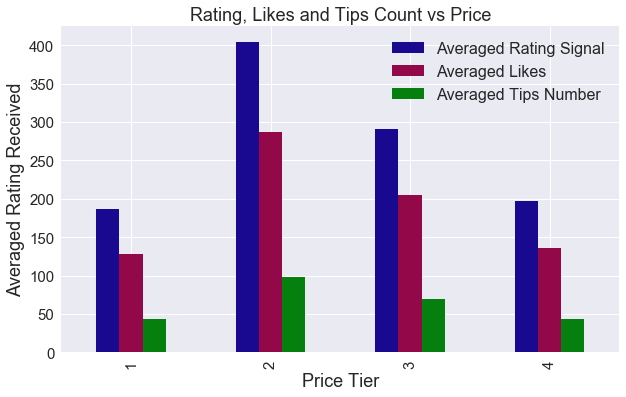

In [365]:
#generate the bar plot for exploring the ratings and tips received with regard to food venue's price tier
price_signal.plot(kind='bar', figsize=(10, 6), color = ['#190890','#920848','#05800E'], fontsize = 15)

plt.xlabel('Price Tier', fontsize = 18) # add to x-label to the plot
plt.ylabel('Averaged Rating Received', fontsize = 18) # add y-label to the plot
plt.title('Rating, Likes and Tips Count vs Price', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 16})

plt.show()

#### Key Insights: 

#### More people are likely to rate (or comment on) food venues with 2 and 3 price tier rather than thoese with 1 and 4 price tier

### 
### 
### 
### Investigate the relationship between price tier and rating

In [313]:
%matplotlib inline
mpl.style.use('seaborn') 
print('Matplotlib version: ', mpl.__version__) 

Matplotlib version:  3.1.3


In [366]:
# create the dataframe for processing and cleaning
df_rp = pd.DataFrame()
df_rp['Rating']= ny_rate_price['Rating'].astype('float64')
df_rp['Price']= ny_rate_price['Price'].astype('int32')

# extract the rows regarding various price tier
rate1 = df_rp[df_rp['Price'] == 1]['Rating'].reset_index()['Rating']
rate2 = df_rp[df_rp['Price'] == 2]['Rating'].reset_index()['Rating']
rate3 = df_rp[df_rp['Price'] == 3]['Rating'].reset_index()['Rating']
rate4 = df_rp[df_rp['Price'] == 4]['Rating'].reset_index()['Rating']

In [367]:
# create the dataframe for investigating the relationship between price tier and rating
df_rp_f = pd.DataFrame(columns = ['Tier 1','Tier 2','Tier 3','Tier 4'])
df_rp_f['Tier 1']=rate1
df_rp_f['Tier 2']=rate2
df_rp_f['Tier 3']=rate3
df_rp_f['Tier 4']=rate4

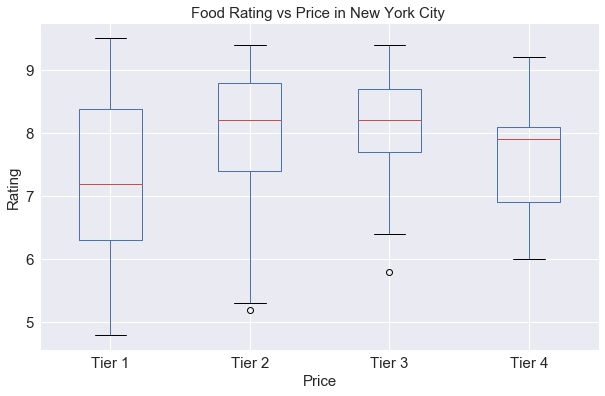

In [368]:
df_rp_f.boxplot(figsize=(10, 6), fontsize = '15')

plt.title('Food Rating vs Price in New York City ',fontsize = '15')
plt.xlabel('Price',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')

plt.show()

In [369]:
# correlation test for price and rating
corr_rp, p_rp = pearsonr(df_rp['Price'], df_rp['Rating'])
print('Pearsons correlation: %.3f' % corr_rp)
print('P value < %.3f' % p_rp)

Pearsons correlation: 0.307
P value < 0.000


#### Key Insights: 

#### 1) Mean rating increases from food venues with price 1 to 3

#### 2) Rating polarization and deviation significantly decreases from food venues with price 1 to 3

#### 3) Mean rating for price tier 4 are slightly lower than that for price tier 3

### 
### 
### 
### Food Venue Count for Individual Category

In [370]:
ny_venues_category = ny_venues.groupby('Venue Category').size().reset_index(name = 'Total Count')
ny_venues_category = ny_venues_category.sort_values(by = 'Total Count', ascending=False).set_index('Venue Category')

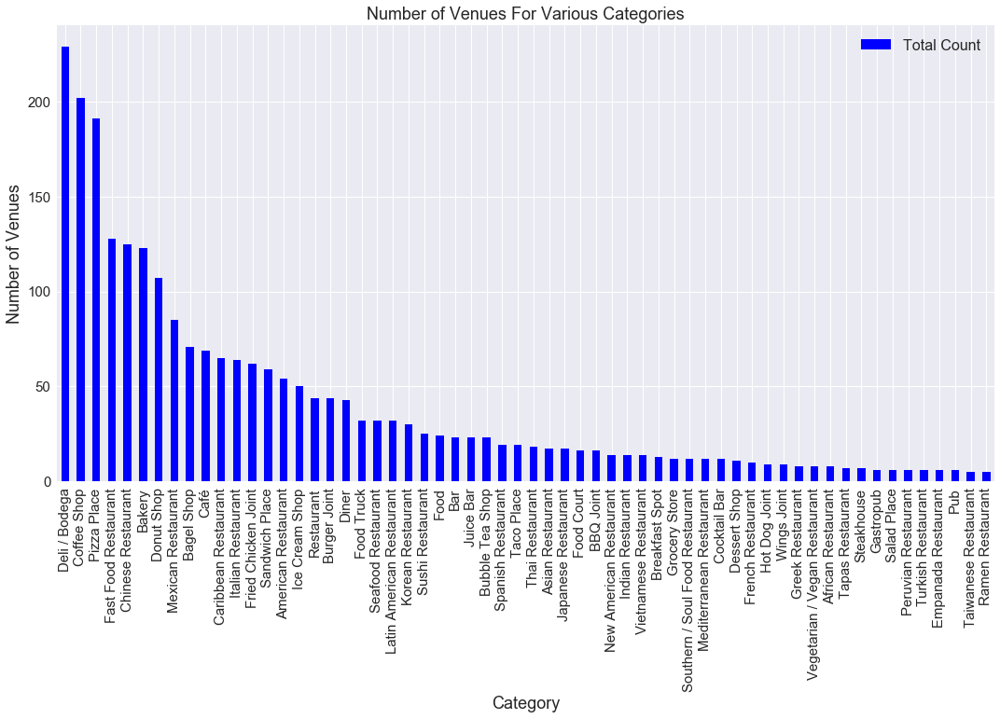

In [371]:
ny_venues_category.iloc[0:60].plot(kind='bar', figsize=(18, 9), color = 'blue', fontsize = 15)

plt.xlabel('Category', fontsize = 18) # add to x-label to the plot
plt.ylabel('Number of Venues', fontsize = 18) # add y-label to the plot
plt.title('Number of Venues For Various Categories', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 16})
plt.show()

### 
### 
### 
### Average Likes for Individual Category

In [372]:
ny_rating_category = ny_rating.groupby('Venue Category').mean().reset_index()
ny_rating_category = ny_rating_category.sort_values(by = 'Likes', ascending=False).set_index('Venue Category')
ny_rating_category.drop(columns = ['Community Board Latitude', 'Community Board Longitude',
                                   'Venue Latitude', 'Venue Longitude', 'Rating'], inplace = True)
ny_rating_category_Likes = ny_rating_category[['Likes']]

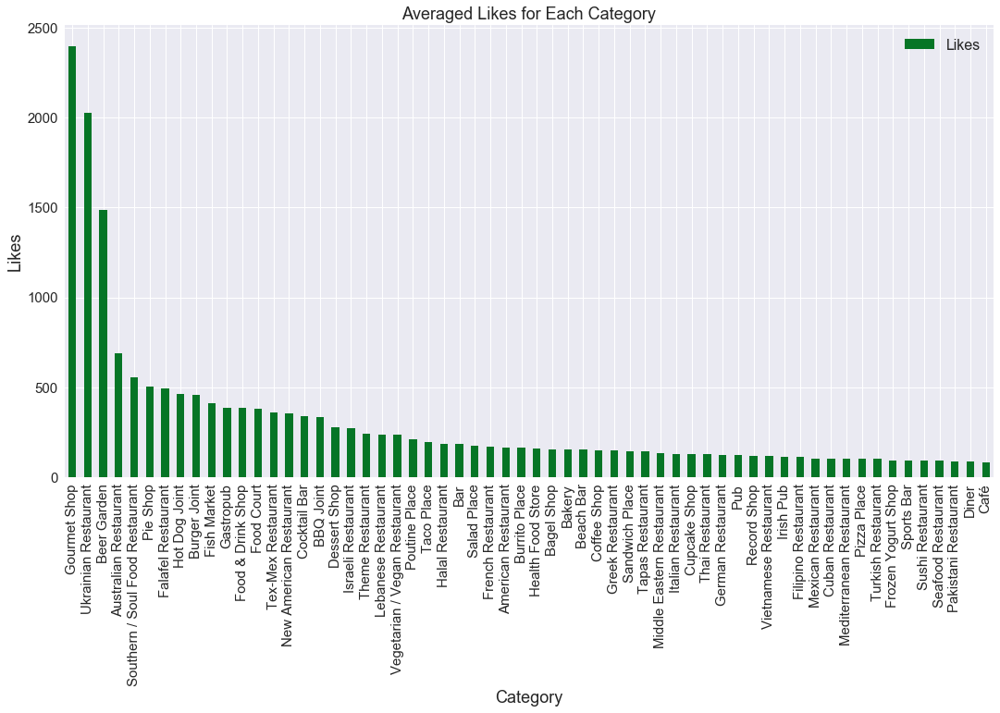

In [373]:
ny_rating_category_Likes.iloc[0:60].plot(kind='bar', figsize=(18, 9), color = '#067526', fontsize = 15)

plt.xlabel('Category', fontsize = 18) # add to x-label to the plot
plt.ylabel('Likes', fontsize = 18) # add y-label to the plot
plt.title('Averaged Likes for Each Category', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 16})
plt.show()

### 
### 
### 
### Average Rating Signal with Individual Category

In [374]:
ny_rating_category_RS = ny_rating_category[['Rating Signal']]
ny_rating_category_RS = ny_rating_category_RS.sort_values(by = 'Rating Signal', ascending=False)

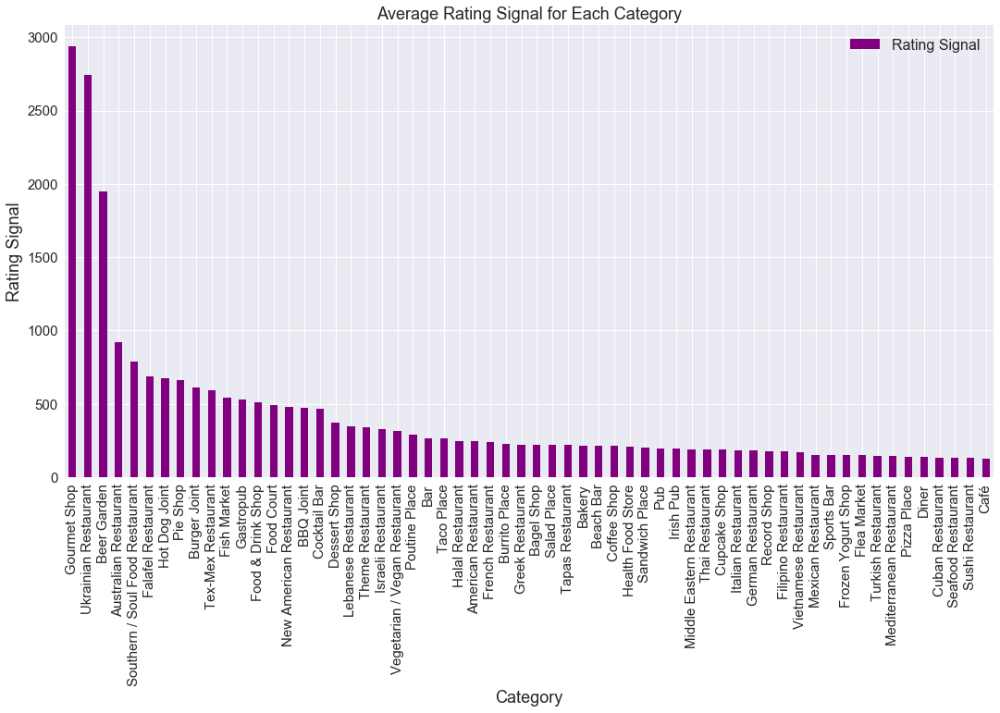

In [375]:
ny_rating_category_RS.iloc[0:60].plot(kind='bar', figsize=(18, 9), color = ['purple'], fontsize = 15)

plt.xlabel('Category', fontsize = 18) # add to x-label to the plot
plt.ylabel('Rating Signal', fontsize = 18) # add y-label to the plot
plt.title('Average Rating Signal for Each Category', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 16})

plt.show()

### 
### 
### 
### Average Listed Count with Individual Category

In [376]:
ny_rating_category_LC = ny_rating_category[['Listed Number']]
ny_rating_category_LC = ny_rating_category_LC.sort_values(by = 'Listed Number', ascending=False)

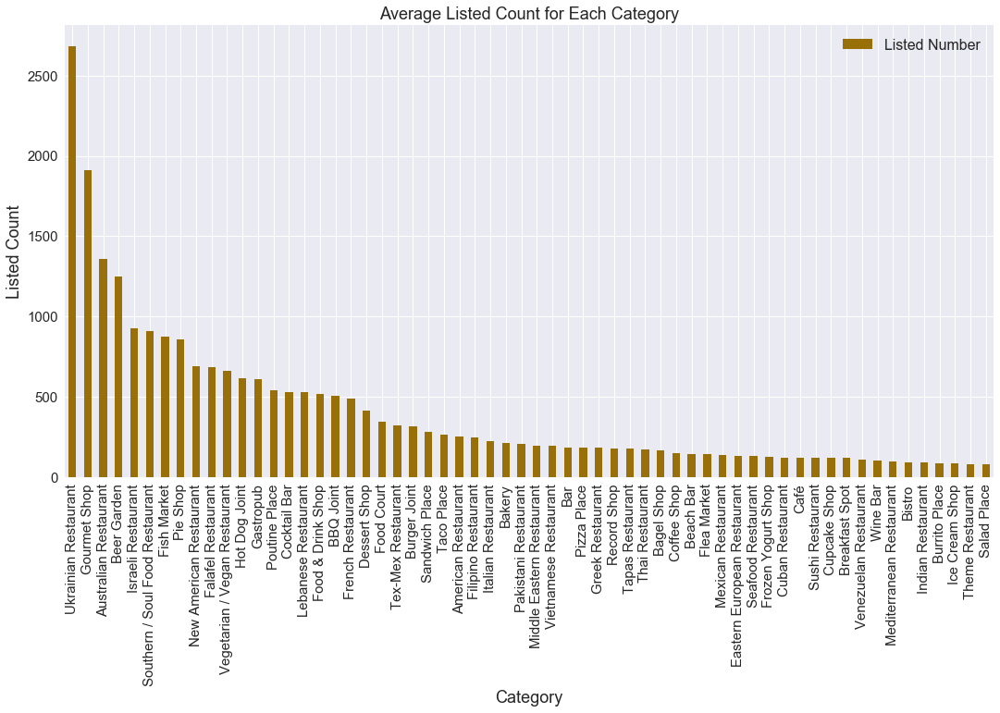

In [377]:
ny_rating_category_LC.iloc[0:60].plot(kind='bar', figsize=(18, 9), color = ['#986F08'], fontsize = 15)

plt.xlabel('Category', fontsize = 18) # add to x-label to the plot
plt.ylabel('Listed Count', fontsize = 18) # add y-label to the plot
plt.title('Average Listed Count for Each Category', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 16})

plt.show()

### 
### 
### 
### Ratings of Various Food Venue Category

In [696]:
#set the columns
columns_category = ny_rating['Venue Category'].unique()
#create the dataframe for analysis
df_rating = pd.DataFrame(columns = columns_category)
#get the ratings for each individual category
for column in ny_rating['Venue Category'].unique():
    df_rating[column] = ny_rating[ny_rating['Venue Category'] == column].reset_index()['Rating']
    
meds = df_rating.median()
meds.sort_values(ascending=False, inplace=True)
df_rating = df_rating[meds.index]

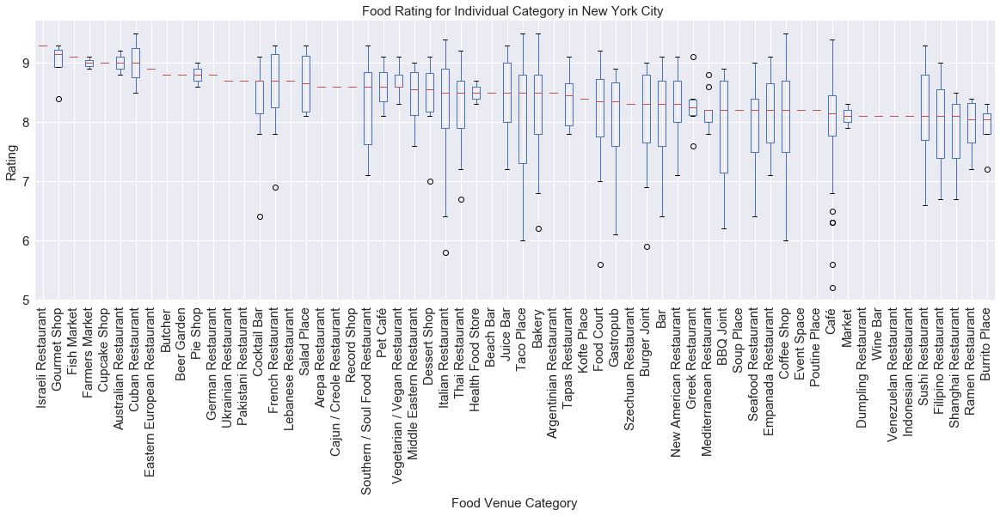

In [379]:
#generate the boxplot of ratings regarding food venue category
df_rating.iloc[:,0:df_rating.shape[1]//2].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Food Rating for Individual Category in New York City ',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')

plt.show()

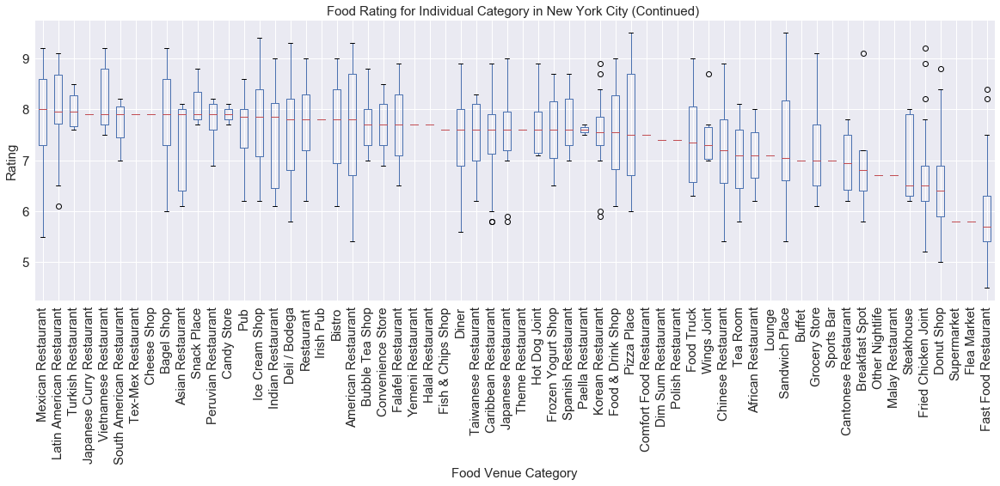

In [380]:
#generate the boxplot of ratings regarding food venue category
df_rating.iloc[:,df_rating.shape[1]//2:].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Food Rating for Individual Category in New York City (Continued) ',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')

plt.show()

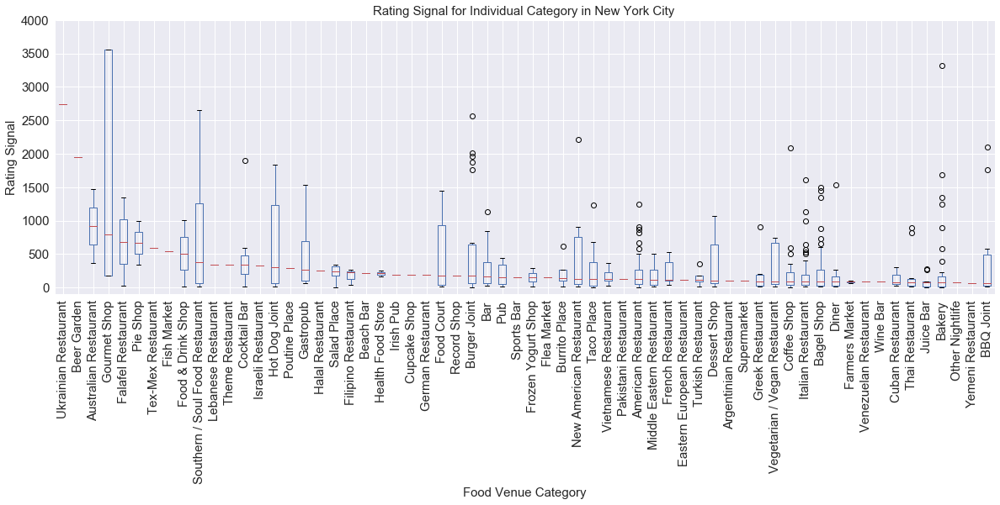

In [687]:
#set the columns
columns_category = ny_rating['Venue Category'].unique()
#create the dataframe for analysis
df_rating = pd.DataFrame(columns = columns_category)
#get the ratings for each individual category
for column in ny_rating['Venue Category'].unique():
    df_rating[column] = ny_rating[ny_rating['Venue Category'] == column].reset_index()['Rating Signal']
    
meds = df_rating.median()
meds.sort_values(ascending=False, inplace=True)
df_rating = df_rating[meds.index]

#generate the boxplot of ratings regarding food venue category
df_rating.iloc[:,0:df_rating.shape[1]//2].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Rating Signal for Individual Category in New York City ',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Rating Signal', fontsize = '15')
plt.ylim(-100,4000)

plt.show()

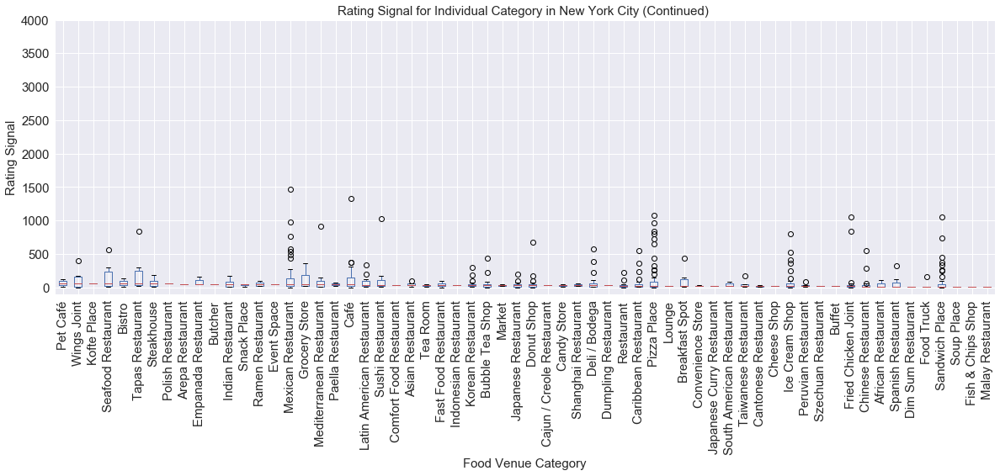

In [695]:
#generate the boxplot of ratings regarding food venue category
df_rating.iloc[:,df_rating.shape[1]//2:].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Rating Signal for Individual Category in New York City (Continued) ',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Rating Signal', fontsize = '15')
plt.ylim(-100,4000)
plt.show()

### 
### 
### 
### Price of Food Venue Category

In [381]:
#set the columns
columns_category_p = ny_price['Venue Category'].unique()
#create the dataframe for analysis
df_price = pd.DataFrame(columns = columns_category_p)
#get the ratings for each individual category
for column in ny_price['Venue Category'].unique():
    df_price[column] = ny_price[ny_price['Venue Category'] == column].reset_index()['Price']
    
meds0 = df_price.median()
meds0.sort_values(ascending=False, inplace=True)
df_price = df_price[meds0.index]

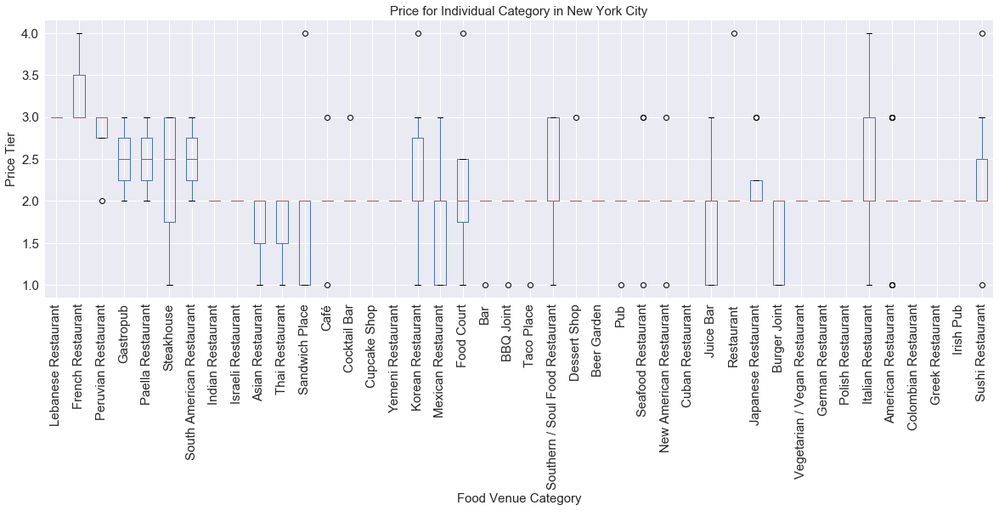

In [382]:
#generate the boxplot of ratings regarding food venue category
df_price.iloc[:,0:df_price.shape[1]//2].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Price for Individual Category in New York City',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Price Tier', fontsize = '15')

plt.show()

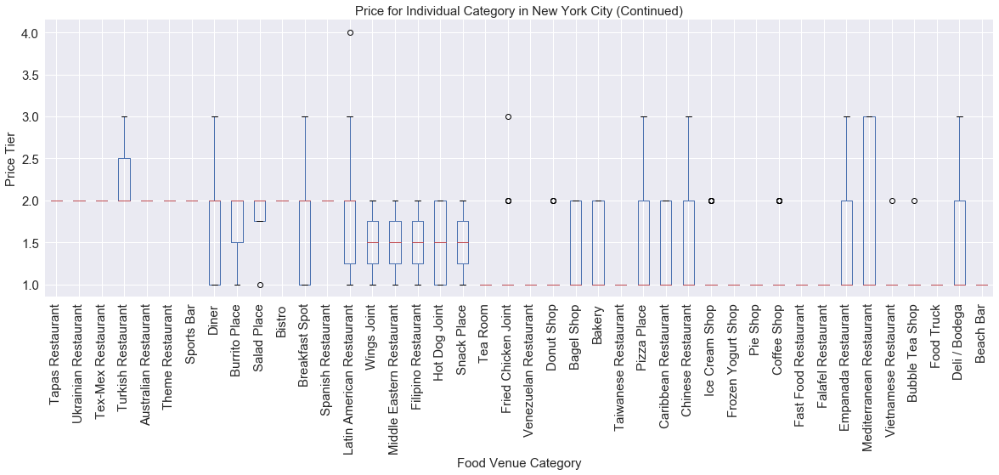

In [385]:
#generate the boxplot of ratings regarding food venue category
df_price.iloc[:,df_price.shape[1]//2:].boxplot(figsize=(20, 6), fontsize = '15', rot = 90)

plt.title('Price for Individual Category in New York City (Continued)',fontsize = '15')
plt.xlabel('Food Venue Category',fontsize = '15')
plt.ylabel('Price Tier', fontsize = '15')

plt.show()

### 
### 
### 
### Investigate the correlation regarding price tier

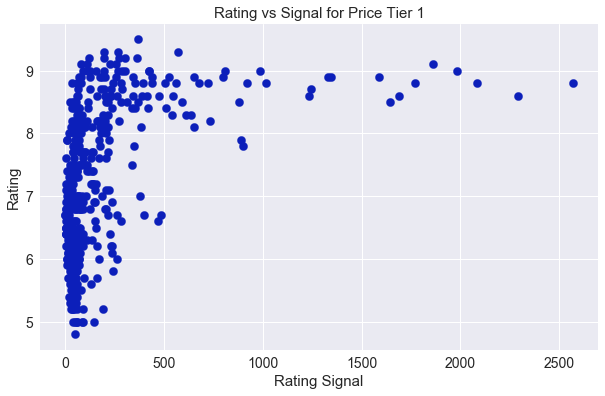

In [386]:
# correlation test for price tier 1
ny_rating_1 = ny_rating[ny_rating['Price'] == 1]
ny_rating_1.plot(kind='scatter', x = 'Rating Signal', y = 'Rating', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = 14)
plt.xlabel('Rating Signal',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')
plt.title('Rating vs Signal for Price Tier 1', fontsize = 15) # add title to the plot
plt.show()

In [387]:
# correlation test for price tier 1
corr_1, p_1 = pearsonr(ny_rating_1['Rating Signal'], ny_rating_1['Rating'])
print('Pearsons correlation: %.3f' % corr_1)
print('P value < %.3f' % p_1)

Pearsons correlation: 0.444
P value < 0.000


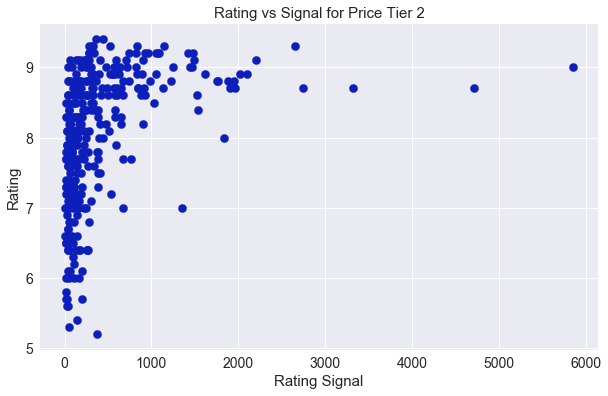

In [388]:
# correlation test for price tier 2
ny_rating_2 = ny_rating[ny_rating['Price'] == 2]
ny_rating_2.plot(kind='scatter', x = 'Rating Signal', y = 'Rating', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = 14)
plt.xlabel('Rating Signal',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')
plt.title('Rating vs Signal for Price Tier 2', fontsize = 15) # add title to the plot
plt.show()

In [389]:
# correlation test for price tier 2
corr_2, p_2 = pearsonr(ny_rating_2['Rating Signal'], ny_rating_2['Rating'])
print('Pearsons correlation: %.3f' % corr_2)
print('P value < %.3f' % p_2)

Pearsons correlation: 0.377
P value < 0.000


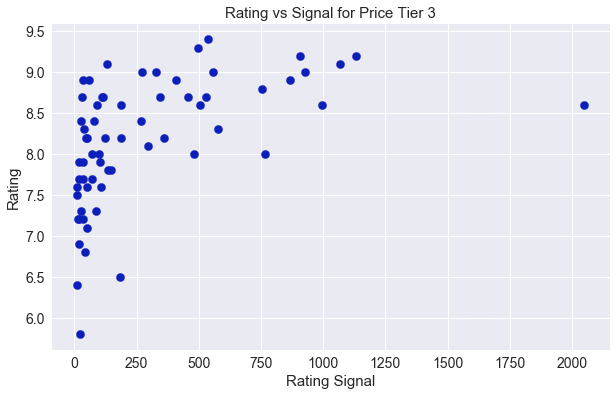

In [390]:
# correlation test for price tier 3
ny_rating_3 = ny_rating[ny_rating['Price'] == 3]
ny_rating_3.plot(kind='scatter', x = 'Rating Signal', y = 'Rating', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = 14)
plt.xlabel('Rating Signal',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')
plt.title('Rating vs Signal for Price Tier 3', fontsize = 15) # add title to the plot
plt.show()

In [391]:
# correlation test for price tier 3
corr_3, p_3 = pearsonr(ny_rating_3['Rating Signal'], ny_rating_3['Rating'])
print('Pearsons correlation: %.3f' % corr_3)
print('P value < %.3f' % p_3)

Pearsons correlation: 0.502
P value < 0.000


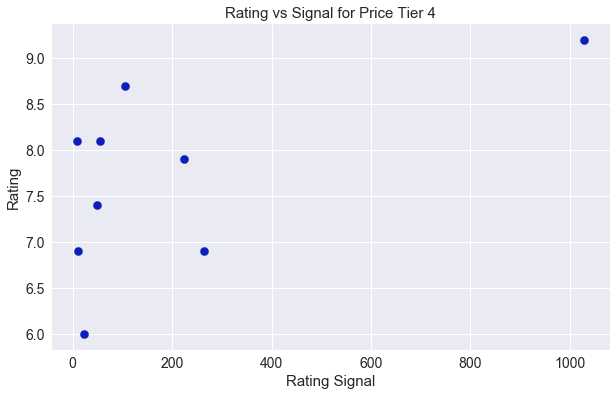

In [392]:
# correlation test for price tier 4
ny_rating_4 = ny_rating[ny_rating['Price'] == 4]
ny_rating_4.plot(kind='scatter', x = 'Rating Signal', y = 'Rating', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')
plt.title('Rating vs Signal for Price Tier 4', fontsize = 15) # add title to the plot
plt.show()

In [393]:
# correlation test for price tier 4
corr_4, p_4 = pearsonr(ny_rating_4['Rating Signal'], ny_rating_4['Rating'])
print('Pearsons correlation: %.3f' % corr_4)
print('P value < %.3f' % p_4)

Pearsons correlation: 0.567
P value < 0.111


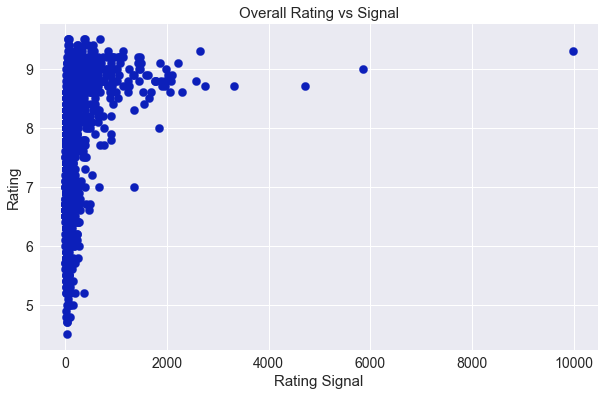

In [668]:
ny_rating.plot(kind='scatter', x = 'Rating Signal', y = 'Rating', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = 14)
plt.xlabel('Rating Signal',fontsize = '15')
plt.ylabel('Rating', fontsize = '15')
plt.title('Overall Rating vs Signal', fontsize = 15) # add title to the plot
plt.show()

In [669]:
# correlation test overrall
corr, p = pearsonr(ny_rating['Rating Signal'], ny_rating['Rating'])
print('Pearsons correlation: %.3f' % corr)
print('P value < %.3f' % p)

Pearsons correlation: 0.309
P value < 0.000


In [396]:
df_rating = df_rating.describe().fillna(0)

In [397]:
#set the columns
columns_category = ny_rating['Venue Category'].unique()
#create the dataframe for analysis
df_rs = pd.DataFrame(columns = columns_category)
#get the ratings for each individual category
for column in ny_rating['Venue Category'].unique():
    df_rs[column] = ny_rating[ny_rating['Venue Category'] == column].reset_index()['Rating Signal']
    
meds_rs = df_rs.median()
meds_rs.sort_values(ascending=False, inplace=True)
df_rs = df_rs[meds_rs.index]

In [398]:
df_rs = df_rs.describe().fillna(0)

In [399]:
rating_ratingsignal = pd.DataFrame(columns = columns_category)

In [400]:
rating_ratingsignal = rating_ratingsignal.append(df_rating.loc['mean',:])
rating_ratingsignal = rating_ratingsignal.append(df_rating.loc['std',:])
rating_ratingsignal = rating_ratingsignal.append(df_rs.loc['mean',:])
rating_ratingsignal = rating_ratingsignal.append(df_rs.loc['std',:])

In [401]:
rating_ratingsignal = rating_ratingsignal.T

In [402]:
rating_ratingsignal.columns = ['rating mean', 'rating std', 'signal mean', 'signal std']

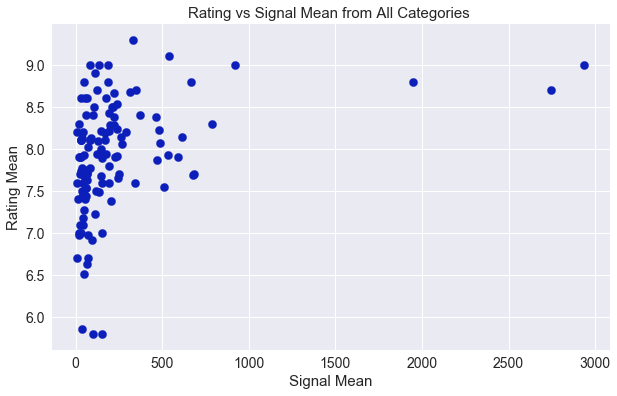

In [403]:
rating_ratingsignal.plot(kind='scatter', x = 'signal mean', y = 'rating mean', s = 68, c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Signal Mean',fontsize = '15')
plt.ylabel('Rating Mean', fontsize = '15')
plt.title('Rating vs Signal Mean from All Categories ', fontsize = 15) # add title to the plot
plt.show()

In [404]:
rating_ratingsignal.corr(method='pearson').round(3)

,rating mean,rating std,signal mean,signal std
rating mean,1.000,-0.246,0.336,0.184
rating std,-0.246,1.000,-0.039,0.231
signal mean,0.336,-0.039,1.000,0.652
signal std,0.184,0.231,0.652,1.000


In [405]:
def pearsonr_pval(x,y):
    return pearsonr(x,y)[1]

In [406]:
rating_ratingsignal.corr(method=pearsonr_pval).round(3)

,rating mean,rating std,signal mean,signal std
rating mean,1.000,0.006,0.000,0.041
rating std,0.006,1.000,0.671,0.010
signal mean,0.000,0.671,1.000,0.000
signal std,0.041,0.010,0.000,1.000


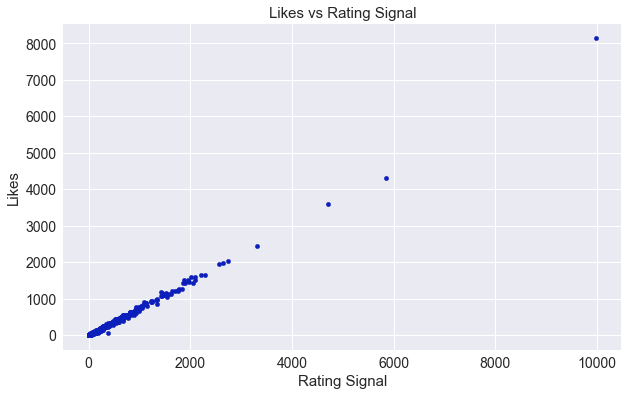

In [407]:
ny_rating.plot(kind='scatter', x = 'Rating Signal', y = 'Likes', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Likes', fontsize = '15')
plt.title('Likes vs Rating Signal', fontsize = 15) # add title to the plot
plt.show()

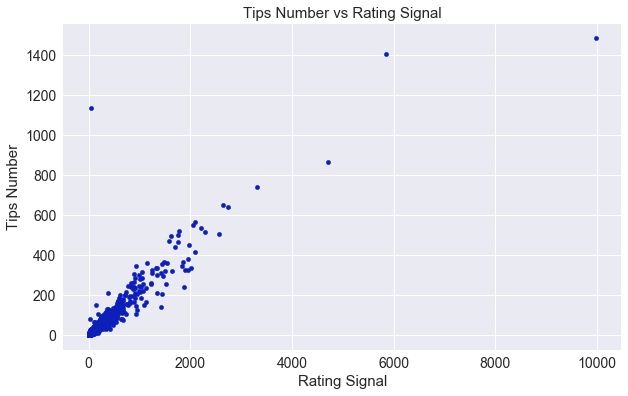

In [408]:
ny_rating.plot(kind='scatter', x = 'Rating Signal', y = 'Tips Number', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Tips Number', fontsize = '15')
plt.title('Tips Number vs Rating Signal', fontsize = 15) # add title to the plot
plt.show()

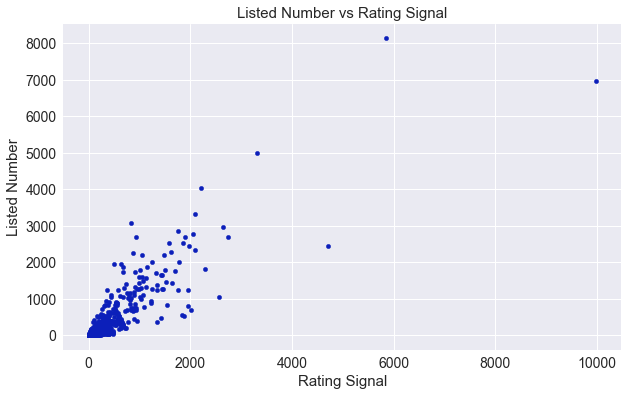

In [409]:
ny_rating.plot(kind='scatter', x = 'Rating Signal', y = 'Listed Number', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Listed Number', fontsize = '15')
plt.title('Listed Number vs Rating Signal', fontsize = 15) # add title to the plot
plt.show()

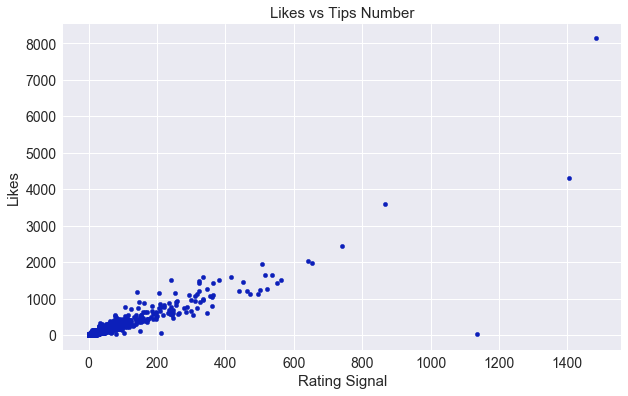

In [588]:
ny_rating.plot(kind='scatter', x = 'Tips Number', y = 'Likes', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Likes', fontsize = '15')
plt.title('Likes vs Tips Number', fontsize = 15) # add title to the plot
plt.show()

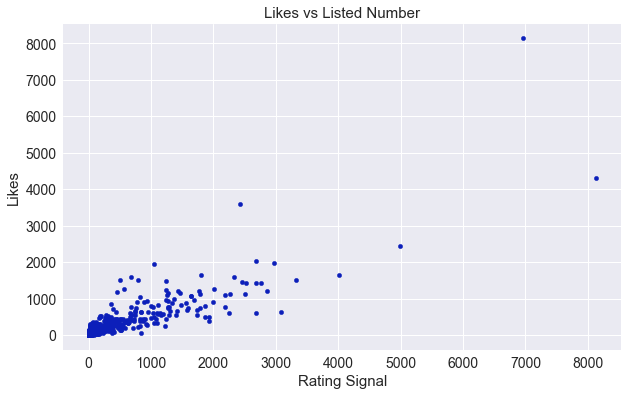

In [589]:
ny_rating.plot(kind='scatter', x = 'Listed Number', y = 'Likes', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Likes', fontsize = '15')
plt.title('Likes vs Listed Number', fontsize = 15) # add title to the plot
plt.show()

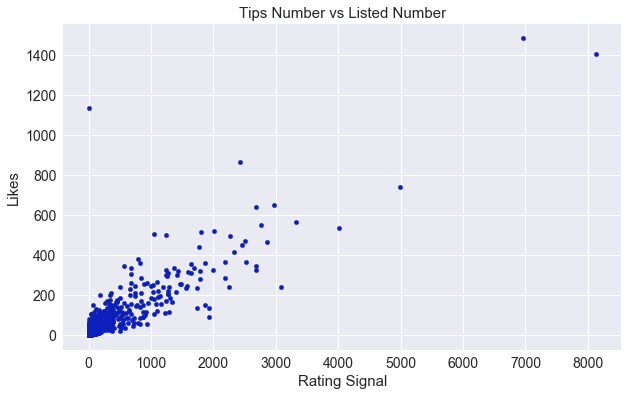

In [590]:
ny_rating.plot(kind='scatter', x = 'Listed Number', y = 'Tips Number', c = '#0C1FBA', figsize=(10, 6), fontsize = '14')
plt.xlabel('Rating Signal', fontsize = '15')
plt.ylabel('Likes', fontsize = '15')
plt.title('Tips Number vs Listed Number', fontsize = 15) # add title to the plot
plt.show()

In [411]:
ny_rating_sig_tip_lik_lis = ny_rating[['Rating Signal','Tips Number','Likes','Listed Number']]

In [593]:
ny_rating_sig_tip_lik_lis.corr().round(3)

,Rating Signal,Tips Number,Likes,Listed Number
Rating Signal,1.000000,0.921110,0.997467,0.884135
Tips Number,0.921110,1.000000,0.905172,0.881586
Likes,0.997467,0.905172,1.000000,0.874337
Listed Number,0.884135,0.881586,0.874337,1.000000


In [597]:
ny_rating_sig_tip_lik_lis.corr(method=pearsonr_pval)

,Rating Signal,Tips Number,Likes,Listed Number
Rating Signal,1.0,0.0,0.0,0.0
Tips Number,0.0,1.0,0.0,0.0
Likes,0.0,0.0,1.0,0.0
Listed Number,0.0,0.0,0.0,1.0


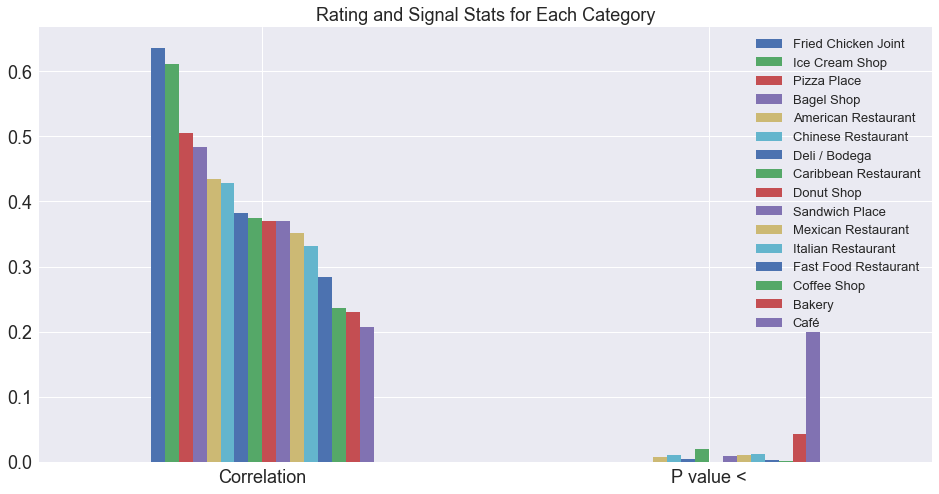

In [675]:
# correlation test
df_test = pd.DataFrame()
for venue in ny_venues_category.index[0:16]:
    ny_cs = ny_rating[ny_rating['Venue Category'] == venue]
    try:
        corr_ch, p_ch = pearsonr(ny_cs['Rating Signal'], ny_cs['Rating'])
    except:
        corr_ch = 0
        p_ch = 0
        
    df_test[venue] = pd.Series([corr_ch, p_ch]) 
    
    corr_ch = 0
    p_ch = 0
   
    #print('Pearsons correlation: %.3f' % corr_ch)
    #print('P value < %.3f' % p_ch)
    
df_test.index = ['Correlation', 'P value <']
df_test = df_test.sort_values(by = 'Correlation', axis = 1, ascending = False)

ax = df_test.plot(kind = 'bar', figsize = (16, 8), fontsize = 18, rot = 0)


plt.title('Rating and Signal Stats for Each Category', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 13})
plt.show()

In [676]:
df_test

,Fried Chicken Joint,Ice Cream Shop,Pizza Place,Bagel Shop,American Restaurant,Chinese Restaurant,Deli / Bodega,Caribbean Restaurant,Donut Shop,Sandwich Place,Mexican Restaurant,Italian Restaurant,Fast Food Restaurant,Coffee Shop,Bakery,Café
Correlation,0.636304,0.610758,5.056738e-01,0.484374,0.434308,0.429094,0.381917,0.375299,0.370444,0.369191,0.351681,0.331330,0.283960,0.236543,0.230232,0.206941
P value <,0.000006,0.000028,3.957549e-10,0.000117,0.007234,0.010107,0.004774,0.020244,0.000108,0.008328,0.009815,0.011815,0.002201,0.001729,0.042575,0.200113


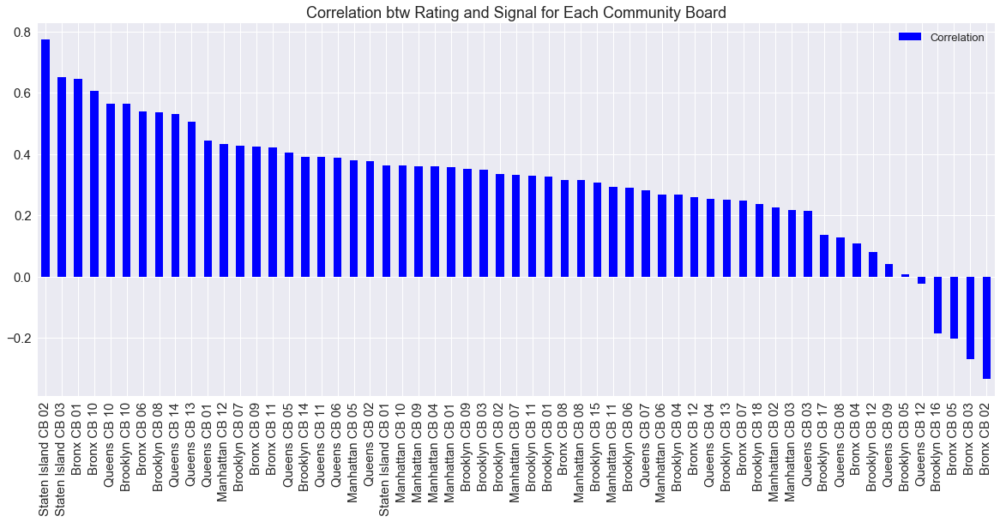

In [663]:
# correlation test
df_testb = pd.DataFrame()
cbs = ny_rating['Community Board'].unique()
for cb in cbs:
    ny_cb = ny_rating[ny_rating['Community Board'] == cb]
    try:
        corr_cb, p_cb = pearsonr(ny_cb['Rating Signal'], ny_cb['Rating'])
    except:
        corr_cb = 0
        p_cb = 0
        
    df_testb[cb] = pd.Series([corr_cb, p_cb]) 
    
    corr_cb = 0
    p_cb = 0
   
    #print('Pearsons correlation: %.3f' % corr_ch)
    #print('P value < %.3f' % p_ch)
    
df_testb.index = ['Correlation', 'P value']
df_testb = df_testb.sort_values(by = 'Correlation', axis = 1, ascending = False)

df_testb.iloc[0,:].plot(kind = 'bar', figsize = (20, 8), color = 'blue', fontsize = 15, rot = 90)

plt.title('Correlation btw Rating and Signal for Each Community Board', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 13})
plt.show()

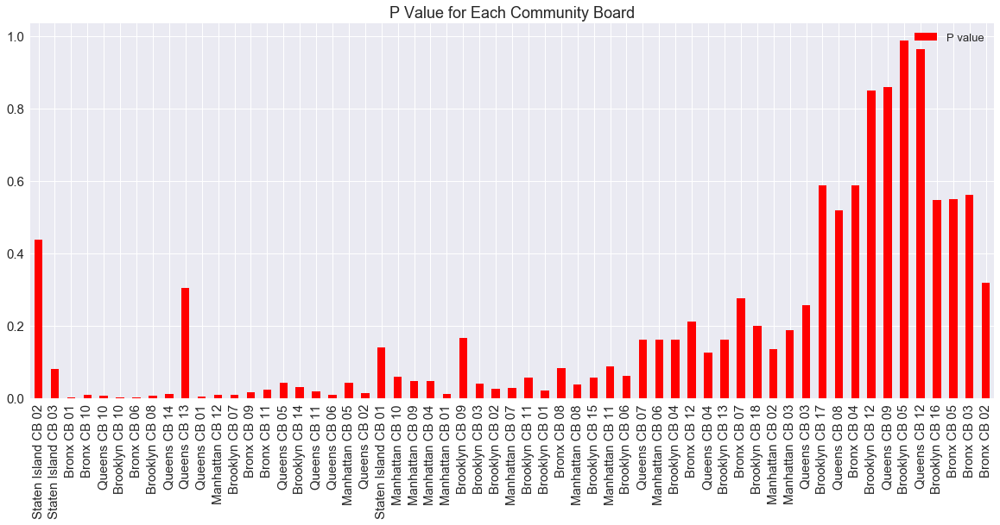

In [664]:
df_testb.iloc[1,:].plot(kind = 'bar', figsize = (20, 8), color = 'red', fontsize = 15, rot = 90)

plt.title('P Value for Each Community Board', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 13})
plt.show()

In [ ]:
df_testb.index = 'Correlation'
df_testb = df_testb.sort_values(by = 'Correlation', axis = 1, ascending = False)

df_testb.plot(kind = 'bar', figsize = (16, 8), fontsize = 18, rot = 0)

plt.title('Rating and Signal Stats for Each Category', fontsize = 18) # add title to the plot
plt.legend(loc=1, prop={'size': 13})
plt.show()

### 
### 
### 
### Distinguish Community Boards

In [450]:
ny_coord_p = ny_coord.drop(columns = ['shape_area','shape_leng','Latitude','Longitude'])

In [ ]:
#ny_price_ag = ny_coord_p.join(ny_price_ag.set_index('boro_cd'), on = 'boro_cd')

In [426]:
# change '1' (or '2'...) to '01' (or '02'...)
def zfill2(row):
    list = row.split('\xa0')
    list[-1] = list[-1].zfill(2)
    return ' '.join(list)

In [427]:
ny_venues['Community Board'] = ny_venues['Community Board'].apply(zfill2)

In [428]:
# one hot encoding
ny_onehot = pd.get_dummies(ny_venues[['Venue Category']], prefix="", prefix_sep="")

# add Community Board column back to dataframe
ny_onehot['Community Board'] = ny_venues['Community Board'] 

# move Community Board column to the first column
fixed_columns = [ny_onehot.columns[-1]] + list(ny_onehot.columns[:-1])
ny_onehot = ny_onehot[fixed_columns]

ny_onehot.head()

,Community Board,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Asian Restaurant,Australian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beach Bar,Beer Garden,Bistro,Breakfast Spot,Bubble Tea Shop,Buffet,Burger Joint,Burrito Place,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Colombian Restaurant,Comfort Food Restaurant,Convenience Store,Cuban Restaurant,Cupcake Shop,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Gastropub,German Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Halal Restaurant,Health Food Store,Hookah Bar,Hot Dog Joint,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Indoor Play Area,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Juice Bar,Kofte Place,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Lebanese Restaurant,Lounge,Malay Restaurant,Market,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Modern European Restaurant,New American Restaurant,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pet Café,Pie Shop,Pizza Place,Poke Place,Polish Restaurant,Poutine Place,Pub,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Salvadoran Restaurant,Sandwich Place,Seafood Restaurant,Shanghai Restaurant,Smoothie Shop,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Souvlaki Shop,Spanish Restaurant,Sports Bar,Steakhouse,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Theme Restaurant,Turkish Restaurant,Ukrainian Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Wine Bar,Wings Joint,Yemeni Restaurant
0,Bronx CB 01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Bronx CB 01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,Bronx CB 01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,Bronx CB 01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,Bronx CB 01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [429]:
ny_onehot_grouped = ny_onehot.groupby('Community Board').mean().reset_index()
ny_onehot_grouped.head()

,Community Board,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Asian Restaurant,Australian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beach Bar,Beer Garden,Bistro,Breakfast Spot,Bubble Tea Shop,Buffet,Burger Joint,Burrito Place,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Colombian Restaurant,Comfort Food Restaurant,Convenience Store,Cuban Restaurant,Cupcake Shop,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Gastropub,German Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Halal Restaurant,Health Food Store,Hookah Bar,Hot Dog Joint,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Indoor Play Area,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Juice Bar,Kofte Place,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Lebanese Restaurant,Lounge,Malay Restaurant,Market,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Modern European Restaurant,New American Restaurant,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pet Café,Pie Shop,Pizza Place,Poke Place,Polish Restaurant,Poutine Place,Pub,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Salvadoran Restaurant,Sandwich Place,Seafood Restaurant,Shanghai Restaurant,Smoothie Shop,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Souvlaki Shop,Spanish Restaurant,Sports Bar,Steakhouse,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Theme Restaurant,Turkish Restaurant,Ukrainian Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Wine Bar,Wings Joint,Yemeni Restaurant
0,Bronx CB 01,0.020000,0.000000,0.0,0.0,0.0,0.0,0.0,0.02,0.02,0.060000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.0,0.000000,0.060000,0.0,0.0,0.0,0.000000,0.0,0.020000,0.02,0.04,0.0,0.0,0.0,0.0,0.0,0.0,0.080000,0.0,0.0,0.02,0.080000,0.0,0.00,0.000000,0.0,0.0,0.0,0.0,0.140000,0.0,0.0,0.0,0.0,0.020000,0.0,0.00,0.0,0.000000,0.0,0.040000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.00,0.040000,0.0,0.0,0.0,0.040000,0.0,0.0,0.0,0.0,0.0,0.100000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.060000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.020000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.020000,0.00,0.00,0.000000,0.0,0.0,0.02,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
1,Bronx CB 02,0.000000,0.090909,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.030303,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.030303,0.030303,0.0,0.0,0.0,0.000000,0.0,0.121212,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.030303,0.0,0.0,0.00,0.000000,0.0,0.00,0.000000,0.0,0.0,0.0,0.0,0.181818,0.0,0.0,0.0,0.0,0.090909,0.0,0.00,0.0,0.030303,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.060606,0.0,0.0,0.0,0.030303,0.0,0.0,0.0,0.0,0.0,0.030303,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.151515,0.0,0.0,0.0,0.0,0.0,0.0,0.030303,0.0,0.0,0.030303,0.030303,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00,0.00,0.000000,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
2,Bronx CB 03,0.033333,0.000000,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.100000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.033333,0.0,0.066667,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.133333,0.0,0.0,0.00,0.033333,0.0,0.00,0.000000,0.0,0.0,0.0,0.0,0.100000,0.0,0.0,0.0,0.0,0.066667,0.0,

In [430]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [431]:
num_most_food = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Community Board']
for ind in np.arange(num_most_food):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
cb_venues_sorted = pd.DataFrame(columns=columns)
cb_venues_sorted['Community Board'] = ny_onehot_grouped['Community Board']

In [432]:
for ind in np.arange(ny_onehot_grouped.shape[0]):
    cb_venues_sorted.iloc[ind, 1:] = return_most_common_venues(ny_onehot_grouped.iloc[ind, :], num_most_food)

cb_venues_sorted.head()

,Community Board,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Bronx CB 01,Fast Food Restaurant,Mexican Restaurant,Donut Shop,Deli / Bodega,Café,Pizza Place,Bakery,Coffee Shop,Fried Chicken Joint,Juice Bar
1,Bronx CB 02,Fast Food Restaurant,Pizza Place,Chinese Restaurant,Food,American Restaurant,Juice Bar,Restaurant,Café,Cafeteria,Deli / Bodega
2,Bronx CB 03,Deli / Bodega,Seafood Restaurant,Fast Food Restaurant,Pizza Place,Bakery,Food,Chinese Restaurant,Mexican Restaurant,Food Truck,Donut Shop
3,Bronx CB 04,Deli / Bodega,Fast Food Restaurant,Chinese Restaurant,Donut Shop,Sandwich Place,Hot Dog Joint,Seafood Restaurant,Steakhouse,Mexican Restaurant,Pizza Place
4,Bronx CB 05,Mexican Restaurant,Fast Food Restaurant,Pizza Place,Bakery,Deli / Bodega,Fried Chicken Joint,Donut Shop,Restaurant,Chinese Restaurant,African Restaurant


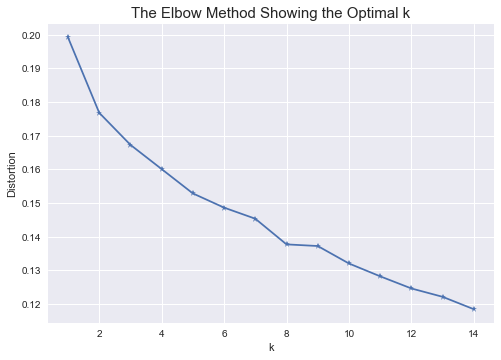

In [780]:
distortions = []
range_n_clusters = range(1,15)
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters)
    fits = clusterer.fit(ny_grouped_clustering)
    score = sum(np.min(cdist(ny_grouped_clustering, fits.cluster_centers_, 'euclidean'), axis=1)) / ny_grouped_clustering.shape[0]
    distortions.append(score)

# Plot the elbow
plt.plot(range_n_clusters, distortions, '*-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method Showing the Optimal K', fontsize = 15)
plt.show()

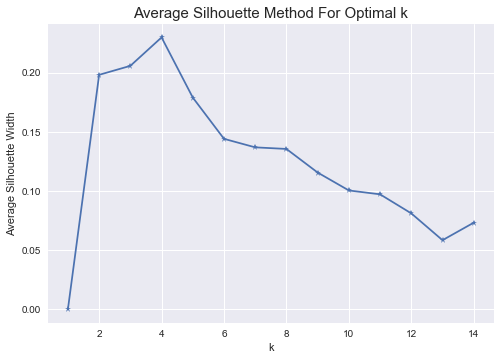

In [785]:
scores = [0]
range_n_clusters = range(2,15)
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(ny_grouped_clustering)
    centers = clusterer.cluster_centers_
    score = silhouette_score(ny_grouped_clustering, preds)
    scores.append(score)
    
plt.plot(range(1,15), scores, '*-')
plt.xlabel('k')
plt.ylabel('Average Silhouette Width')
plt.title('Average Silhouette Method For Optimal k', fontsize = 15)
plt.show()

In [433]:
#### set number of clusters
kclusters = 4

ny_grouped_clustering = ny_onehot_grouped.drop('Community Board', 1)

In [435]:
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(ny_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:40] 

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 0, 0, 1, 0, 1, 0, 1, 0, 2, 1,
       2, 2, 1, 1, 2, 1, 3, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], dtype=int32)

In [436]:
# add clustering labels
cb_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

In [437]:
newyork_merged['Community Board'] = newyork_merged['Community Board'].apply(zfill2)

In [438]:
ny_merged = newyork_merged

# merge to add latitude/longitude for each neighborhood
ny_merged = ny_merged.join(cb_venues_sorted.set_index('Community Board'), on='Community Board')

ny_merged.dropna(inplace=True)

In [439]:
ny_merged['boro_cd'] = ny_merged['boro_cd'].astype('str')

In [455]:
ny_merged = ny_coord_p.join(ny_merged.drop(columns = 'geometry').set_index('boro_cd'), on = 'boro_cd')

In [456]:
ny_merged.dropna(axis = 0, inplace = True)

In [486]:
name = 'Category'
data = ny_merged
quantile = [0,0.4,0.8,1]
colors = ['#F41106','#EDF406','#06F411','#06DEF4']
core_column = 'Cluster Labels'
column = ['Cluster Labels','1st Most Common Venue','2nd Most Common Venue','3rd Most Common Venue']
category = ['Cluster Labels','1st Most Common Venue','2nd Most Common Venue','3rd Most Common Venue']
lengend = 'New York Community Board Clustering on Top Food Category'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity)

In [458]:
ny_merged.loc[ny_merged['Cluster Labels'] == 0, ny_merged.columns[[4] + list(range(12, ny_merged.shape[1]))]]

,Pop.,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,"104,358",Coffee Shop,Pizza Place,Deli / Bodega,Bakery,Bagel Shop,Cuban Restaurant,Taco Place,Mexican Restaurant,Fast Food Restaurant,Latin American Restaurant
13,"44,028",Coffee Shop,Donut Shop,Deli / Bodega,Taco Place,Fast Food Restaurant,Bubble Tea Shop,Bakery,Pizza Place,Diner,Café
15,"96,076",Coffee Shop,Deli / Bodega,Pizza Place,Caribbean Restaurant,Café,Grocery Store,Taco Place,Mexican Restaurant,Ethiopian Restaurant,Seafood Restaurant
20,"34,420",Coffee Shop,Burger Joint,Italian Restaurant,Food Court,Fast Food Restaurant,Pizza Place,Taco Place,Seafood Restaurant,Grocery Store,Mediterranean Restaurant
23,"98,620",Coffee Shop,Italian Restaurant,Burger Joint,Pizza Place,Sandwich Place,Café,Diner,Donut Shop,Bakery,Gourmet Shop
28,"93,119",Coffee Shop,Italian Restaurant,Bakery,American Restaurant,Deli / Bodega,Sandwich Place,Ice Cream Shop,French Restaurant,Pizza Place,Grocery Store
29,"87,479",Coffee Shop,Bagel Shop,Food Court,Bakery,Mexican Restaurant,Donut Shop,Burger Joint,Sushi Restaurant,Restaurant,Irish Pub
31,"207,699",Coffee Shop,Bakery,Bagel Shop,Ice Cream Shop,American Restaurant,Juice Bar,Café,Pizza Place,Burger Joint,Salad Place
38,"104,054",Coffee Shop,Bakery,Bagel Shop,Deli / Bodega,Donut Shop,Ice Cream Shop,Pizza Place,Bar,Dumpling Restaurant,Sandwich Place
39,"160,338",Coffee Shop,Pizza Place,Deli / Bodega,Donut Shop,Italian Restaurant,American Restaurant,Pub,Bagel Shop,New American Restaurant,Grocery Store


In [459]:
ny_merged.loc[ny_merged['Cluster Labels'] == 1, ny_merged.columns[[4] + list(range(12, ny_merged.shape[1]))]]

,Pop.,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,"106,120",Pizza Place,Hot Dog Joint,Bagel Shop,Ice Cream Shop,Sandwich Place,Mexican Restaurant,Fast Food Restaurant,Donut Shop,Latin American Restaurant,Italian Restaurant
4,"83,268",Italian Restaurant,Deli / Bodega,Pizza Place,Bakery,Fast Food Restaurant,Donut Shop,Café,Diner,Restaurant,Mexican Restaurant
7,"167,005",Deli / Bodega,Thai Restaurant,Bubble Tea Shop,Chinese Restaurant,Fried Chicken Joint,Vietnamese Restaurant,Coffee Shop,Bakery,Mexican Restaurant,Taiwanese Restaurant
8,"85,343",Deli / Bodega,Pizza Place,Chinese Restaurant,Donut Shop,Bakery,Fish & Chips Shop,Mexican Restaurant,Fast Food Restaurant,Caribbean Restaurant,Southern / Soul Food Restaurant
9,"223,602",Deli / Bodega,Chinese Restaurant,Pizza Place,Caribbean Restaurant,Seafood Restaurant,Restaurant,BBQ Joint,American Restaurant,Southern / Soul Food Restaurant,Bakery
10,"165,911",Deli / Bodega,Pizza Place,Chinese Restaurant,Donut Shop,Mexican Restaurant,Fast Food Restaurant,Italian Restaurant,Greek Restaurant,Café,Polish Restaurant
18,"168,806",Pizza Place,Caribbean Restaurant,Bagel Shop,Deli / Bodega,Café,Chinese Restaurant,Bakery,Mexican Restaurant,Ice Cream Shop,BBQ Joint
19,"143,867",Deli / Bodega,Coffee Shop,Pizza Place,Café,Fried Chicken Joint,Donut Shop,Comfort Food Restaurant,Japanese Restaurant,Cocktail Bar,Chinese Restaurant
24,"127,274",Deli / Bodega,Chinese Restaurant,Ice Cream Shop,Italian Restaurant,Pizza Place,Restaurant,Donut Shop,Fast Food Restaurant,Food Truck,Food
26,"91,497",Fast Food Restaurant,Mexican Restaurant,Donut Shop,Deli / Bodega,Café,Pizza Place,Bakery,Coffee Shop,Fried Chicken Joint,Juice Bar


In [461]:
ny_merged.loc[ny_merged['Cluster Labels'] == 2, ny_merged.columns[[4] + list(range(12, ny_merged.shape[1]))]]

,Pop.,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,"172,129",Chinese Restaurant,Deli / Bodega,Bakery,Cantonese Restaurant,Vietnamese Restaurant,Bubble Tea Shop,Asian Restaurant,Ice Cream Shop,Bagel Shop,Sushi Restaurant
2,"185,046",Bakery,Pizza Place,Deli / Bodega,Café,Ice Cream Shop,Seafood Restaurant,Restaurant,Chinese Restaurant,Coffee Shop,Turkish Restaurant
12,"160,319",Donut Shop,Chinese Restaurant,Sushi Restaurant,Fast Food Restaurant,Bakery,Bagel Shop,Café,Deli / Bodega,Bar,Burger Joint
14,"104,014",Café,Deli / Bodega,Bakery,Caribbean Restaurant,Restaurant,Coffee Shop,Fast Food Restaurant,Donut Shop,Pizza Place,Ramen Restaurant
22,"116,404",Korean Restaurant,Chinese Restaurant,Taiwanese Restaurant,Bakery,Bubble Tea Shop,Fast Food Restaurant,Burger Joint,Coffee Shop,Sushi Restaurant,Café
32,"115,967",American Restaurant,Donut Shop,Bakery,Pizza Place,Deli / Bodega,Coffee Shop,Seafood Restaurant,Bagel Shop,Burger Joint,Restaurant
37,"127,071",Café,Fast Food Restaurant,Coffee Shop,Snack Place,Sandwich Place,Bakery,Ice Cream Shop,Donut Shop,Diner,Dumpling Restaurant
42,"109,920",Donut Shop,Coffee Shop,Fast Food Restaurant,Deli / Bodega,Diner,Pizza Place,Bakery,Filipino Restaurant,Sushi Restaurant,Café
45,"242,952",Korean Restaurant,Coffee Shop,Bakery,Deli / Bodega,Chinese Restaurant,Donut Shop,Asian Restaurant,BBQ Joint,Japanese Restaurant,Pizza Place
59,"146,594",Pizza Place,Fast Food Restaurant,Chinese Restaurant,Sandwich Place,Donut Shop,Deli / Bodega,Japanese Restaurant,Fried Chicken Joint,Coffee Shop,Ice Cream Shop


In [462]:
ny_merged.loc[ny_merged['Cluster Labels'] == 3, ny_merged.columns[[4] + list(range(12, ny_merged.shape[1]))]]

,Pop.,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,"165,753",Caribbean Restaurant,Chinese Restaurant,Bakery,Food,Deli / Bodega,Fried Chicken Joint,Fast Food Restaurant,Wings Joint,Seafood Restaurant,Coffee Shop
21,"196,284",Caribbean Restaurant,Deli / Bodega,Bakery,Fried Chicken Joint,Mexican Restaurant,Food,Chinese Restaurant,Fast Food Restaurant,Restaurant,Pizza Place
47,"152,344",Caribbean Restaurant,Fast Food Restaurant,Bakery,Pizza Place,Deli / Bodega,Chinese Restaurant,Food,Fried Chicken Joint,Food Truck,Seafood Restaurant


### 
### 
### 
### Distinguish Community Boards in terms of Food Venues' Rating

In [464]:
ny_rating['Community Board'] = ny_rating['Community Board'].apply(zfill2)

In [465]:
# one hot encoding
ny_onerate = pd.get_dummies(ny_rating[['Venue Category']], prefix="", prefix_sep="").astype('float64')

ny_onerate.values[ny_onerate == 1.0] = ny_rating['Rating']

# add Community Board column back to dataframe
ny_onerate['Community Board'] = ny_rating['Community Board'] 

# move Community Board column to the first column
fixed_columns = [ny_onerate.columns[-1]] + list(ny_onerate.columns[:-1])
ny_onerate = ny_onerate[fixed_columns]

ny_onerate.head()

,Community Board,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beach Bar,Beer Garden,Bistro,Breakfast Spot,Bubble Tea Shop,Buffet,Burger Joint,Burrito Place,Butcher,Café,Cajun / Creole Restaurant,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Cocktail Bar,Coffee Shop,Comfort Food Restaurant,Convenience Store,Cuban Restaurant,Cupcake Shop,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Gastropub,German Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Halal Restaurant,Health Food Store,Hot Dog Joint,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Juice Bar,Kofte Place,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Lounge,Malay Restaurant,Market,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,New American Restaurant,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pet Café,Pie Shop,Pizza Place,Polish Restaurant,Poutine Place,Pub,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Shanghai Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sports Bar,Steakhouse,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Theme Restaurant,Turkish Restaurant,Ukrainian Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Wine Bar,Wings Joint,Yemeni Restaurant
0,Bronx CB 01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Bronx CB 01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Bronx CB 01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Bronx CB 01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [466]:
ny_onerate.replace(0.0, np.NaN, inplace = True)

In [467]:
ny_onerate_grouped = ny_onerate.groupby('Community Board').mean().round(2).reset_index()
ny_onerate_grouped.head()

,Community Board,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beach Bar,Beer Garden,Bistro,Breakfast Spot,Bubble Tea Shop,Buffet,Burger Joint,Burrito Place,Butcher,Café,Cajun / Creole Restaurant,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Cocktail Bar,Coffee Shop,Comfort Food Restaurant,Convenience Store,Cuban Restaurant,Cupcake Shop,Deli / Bodega,Dessert Shop,Dim Sum Restaurant,Diner,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Event Space,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Gastropub,German Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Halal Restaurant,Health Food Store,Hot Dog Joint,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Juice Bar,Kofte Place,Korean Restaurant,Latin American Restaurant,Lebanese Restaurant,Lounge,Malay Restaurant,Market,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,New American Restaurant,Other Nightlife,Paella Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pet Café,Pie Shop,Pizza Place,Polish Restaurant,Poutine Place,Pub,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Shanghai Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sports Bar,Steakhouse,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tea Room,Tex-Mex Restaurant,Thai Restaurant,Theme Restaurant,Turkish Restaurant,Ukrainian Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Wine Bar,Wings Joint,Yemeni Restaurant
0,Bronx CB 01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.7,7.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,6.20,NaN,NaN,NaN,NaN,NaN,NaN,5.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.90,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Bronx CB 02,NaN,6.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.15,NaN,NaN,NaN,NaN,NaN,NaN,6.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,6.5,NaN,NaN,NaN,NaN,NaN,8.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Bronx CB 03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.1,NaN,NaN,NaN,6.50,NaN,NaN,NaN,NaN,NaN,NaN,5.50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Bronx CB 04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.8,NaN,NaN,NaN,7.4,NaN,NaN,NaN,NaN,7.5,NaN,NaN,6.3,6.43,NaN,NaN,NaN,NaN,NaN,NaN,5.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.6,6.8,NaN,NaN,NaN,NaN,NaN,NaN,7.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.45,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,8.0,NaN,NaN,NaN,NaN,N

In [468]:
ny_onerate_grouped.fillna(0, inplace = True)

In [469]:
num_rating_food = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Community Board']
for ind in np.arange(num_rating_food):
    try:
        columns.append('{}{} Topest Rated Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Topest Rated Venue'.format(ind+1))

# create a new dataframe
cb_rating_sorted = pd.DataFrame(columns=columns)
cb_rating_sorted['Community Board'] = ny_onerate_grouped['Community Board']

for ind in np.arange(ny_onehot_grouped.shape[0]):
    cb_rating_sorted.iloc[ind, 1:] = return_most_common_venues(ny_onerate_grouped.iloc[ind, :], num_rating_food)

cb_rating_sorted.head()

,Community Board,1st Topest Rated Venue,2nd Topest Rated Venue,3rd Topest Rated Venue,4th Topest Rated Venue,5th Topest Rated Venue,6th Topest Rated Venue,7th Topest Rated Venue,8th Topest Rated Venue,9th Topest Rated Venue,10th Topest Rated Venue
0,Bronx CB 01,Mexican Restaurant,Cocktail Bar,Bakery,Diner,Burger Joint,Italian Restaurant,Coffee Shop,Pizza Place,Sandwich Place,Donut Shop
1,Bronx CB 02,Mexican Restaurant,Juice Bar,Sandwich Place,Pizza Place,American Restaurant,Latin American Restaurant,Food Truck,Fast Food Restaurant,Donut Shop,Farmers Market
2,Bronx CB 03,Deli / Bodega,Caribbean Restaurant,Sandwich Place,Donut Shop,Pizza Place,Fast Food Restaurant,Cupcake Shop,Dessert Shop,Dim Sum Restaurant,Diner
3,Bronx CB 04,Steakhouse,Caribbean Restaurant,Theme Restaurant,Japanese Restaurant,Hot Dog Joint,Deli / Bodega,Mexican Restaurant,Sandwich Place,Coffee Shop,Bakery
4,Bronx CB 05,Mexican Restaurant,African Restaurant,Spanish Restaurant,Ice Cream Shop,Donut Shop,Restaurant,Fast Food Restaurant,Fried Chicken Joint,Dim Sum Restaurant,Diner


In [470]:
#### set number of clusters
kclusters_rating = 4

ny_rating_clustering = ny_onerate_grouped.drop('Community Board', 1)

# run k-means clustering
kmeans_rating = KMeans(n_clusters=kclusters_rating, random_state=0).fit(ny_rating_clustering)

# check cluster labels generated for each row in the dataframe
kmeans_rating.labels_[0:40] 

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 3, 1, 2, 1, 2, 1, 2, 1, 2,
       3, 1, 1, 1, 3, 1, 1, 2, 2, 2, 3, 1, 2, 2, 0, 0, 2, 1], dtype=int32)

In [471]:
cb_rating_sorted.insert(0, 'Cluster Labels', kmeans_rating.labels_)

In [473]:
ny_rating_merged = newyork_merged

# merge to add latitude/longitude for each neighborhood
ny_rating_merged = ny_rating_merged.join(cb_rating_sorted.set_index('Community Board'), on='Community Board')

ny_rating_merged.dropna(inplace=True)

ny_rating_merged['boro_cd'] = ny_rating_merged['boro_cd'].astype('str')

In [474]:
ny_rating_merged = ny_coord_p.join(ny_rating_merged.drop(columns = 'geometry').set_index('boro_cd'), on = 'boro_cd')

In [475]:
ny_rating_merged.dropna(axis = 0, inplace = True)

In [487]:

name = 'Rating'
data = ny_rating_merged
quantile = [0,0.1,0.3,1]
colors = ['#F41106','#EDF406','#06F411','#A806F4']
core_column = 'Cluster Labels'
column = ['Cluster Labels','1st Topest Rated Venue','2nd Topest Rated Venue','3rd Topest Rated Venue']
category = ['Cluster Labels','1st Topest Rated Venue','2nd Topest Rated Venue','3rd Topest Rated Venue']
lengend = 'New York Community Board Clustering on Food Category Rating'
Opacity = 1

present_map(name, data, colors, core_column, column, category, lengend, quantile, Opacity)

In [477]:
ny_rating_merged.loc[ny_rating_merged['Cluster Labels'] == 0, ny_rating_merged.columns[[4] + list(range(12, ny_rating_merged.shape[1]))]]

,Pop.,1st Topest Rated Venue,2nd Topest Rated Venue,3rd Topest Rated Venue,4th Topest Rated Venue,5th Topest Rated Venue,6th Topest Rated Venue,7th Topest Rated Venue,8th Topest Rated Venue,9th Topest Rated Venue,10th Topest Rated Venue
31,"207,699",Southern / Soul Food Restaurant,Thai Restaurant,Food & Drink Shop,Salad Place,Burger Joint,Juice Bar,Bakery,Mexican Restaurant,American Restaurant,Bubble Tea Shop
39,"160,338",Café,Sandwich Place,Southern / Soul Food Restaurant,Fish Market,French Restaurant,Bakery,BBQ Joint,New American Restaurant,American Restaurant,Pizza Place
43,"217,063",Bakery,American Restaurant,Thai Restaurant,Dessert Shop,Deli / Bodega,Juice Bar,Ice Cream Shop,Spanish Restaurant,Health Food Store,Mexican Restaurant


In [478]:
ny_rating_merged.loc[ny_rating_merged['Cluster Labels'] == 1, ny_rating_merged.columns[[4] + list(range(12, ny_rating_merged.shape[1]))]]

,Pop.,1st Topest Rated Venue,2nd Topest Rated Venue,3rd Topest Rated Venue,4th Topest Rated Venue,5th Topest Rated Venue,6th Topest Rated Venue,7th Topest Rated Venue,8th Topest Rated Venue,9th Topest Rated Venue,10th Topest Rated Venue
1,"106,120",Ice Cream Shop,Italian Restaurant,Bakery,Candy Store,Bagel Shop,Coffee Shop,Caribbean Restaurant,Hot Dog Joint,Mexican Restaurant,Dessert Shop
2,"185,046",Pizza Place,Ice Cream Shop,Coffee Shop,Deli / Bodega,Café,Pub,Donut Shop,Eastern European Restaurant,Falafel Restaurant,Event Space
4,"83,268",Deli / Bodega,Bakery,Italian Restaurant,Dessert Shop,Café,Cheese Shop,Pizza Place,Diner,Paella Restaurant,Mexican Restaurant
6,"165,753",Chinese Restaurant,Bakery,Fried Chicken Joint,Seafood Restaurant,Caribbean Restaurant,Wings Joint,Fast Food Restaurant,Donut Shop,Dumpling Restaurant,Filipino Restaurant
7,"167,005",Argentinian Restaurant,Mexican Restaurant,Vietnamese Restaurant,Pizza Place,Thai Restaurant,Sushi Restaurant,Venezuelan Restaurant,Asian Restaurant,Japanese Restaurant,Indonesian Restaurant
8,"85,343",Bakery,Fish & Chips Shop,Caribbean Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Diner,Pizza Place,Donut Shop,Restaurant,Fast Food Restaurant
9,"223,602",BBQ Joint,Deli / Bodega,Pizza Place,Caribbean Restaurant,Filipino Restaurant,Dessert Shop,Dim Sum Restaurant,Diner,Donut Shop,Dumpling Restaurant
10,"165,911",Mexican Restaurant,Bakery,Greek Restaurant,Italian Restaurant,Café,Polish Restaurant,Pizza Place,Sandwich Place,Deli / Bodega,Donut Shop
14,"104,014",Tapas Restaurant,Empanada Restaurant,Café,Cocktail Bar,Bakery,BBQ Joint,Ramen Restaurant,Deli / Bodega,Caribbean Restaurant,Chinese Restaurant
18,"168,806",Mediterranean Restaurant,Middle Eastern Restaurant,Coffee Shop,Bakery,Caribbean Restaurant,Tapas Restaurant,Bagel Shop,Pizza Place,Donut Shop,BBQ Joint


In [479]:
ny_rating_merged.loc[ny_rating_merged['Cluster Labels'] == 2, ny_rating_merged.columns[[4] + list(range(12, ny_rating_merged.shape[1]))]]

,Pop.,1st Topest Rated Venue,2nd Topest Rated Venue,3rd Topest Rated Venue,4th Topest Rated Venue,5th Topest Rated Venue,6th Topest Rated Venue,7th Topest Rated Venue,8th Topest Rated Venue,9th Topest Rated Venue,10th Topest Rated Venue
3,"104,358",Italian Restaurant,Taco Place,Mexican Restaurant,Korean Restaurant,Thai Restaurant,Pakistani Restaurant,Deli / Bodega,Bagel Shop,Latin American Restaurant,Ice Cream Shop
13,"44,028",Gourmet Shop,Pizza Place,Vegetarian / Vegan Restaurant,Burger Joint,Korean Restaurant,Taco Place,Café,Bakery,Fast Food Restaurant,Coffee Shop
15,"96,076",Bistro,American Restaurant,Mexican Restaurant,Café,Bagel Shop,Taco Place,Caribbean Restaurant,Italian Restaurant,Pizza Place,Seafood Restaurant
20,"34,420",Salad Place,Breakfast Spot,Gourmet Shop,Snack Place,Pizza Place,Food Court,Burger Joint,Bagel Shop,Burrito Place,Bubble Tea Shop
28,"93,119",Sushi Restaurant,Salad Place,Australian Restaurant,Grocery Store,Vegetarian / Vegan Restaurant,American Restaurant,Pizza Place,Sandwich Place,French Restaurant,Falafel Restaurant
34,"194,653",Ice Cream Shop,Café,Deli / Bodega,American Restaurant,Pizza Place,Peruvian Restaurant,Burger Joint,Donut Shop,Bagel Shop,Diner
38,"104,054",Cuban Restaurant,Ice Cream Shop,Pizza Place,Sandwich Place,Pie Shop,Deli / Bodega,Frozen Yogurt Shop,Wings Joint,Mexican Restaurant,Record Shop
41,"111,724",Cocktail Bar,BBQ Joint,Italian Restaurant,Latin American Restaurant,Salad Place,Burger Joint,Japanese Curry Restaurant,Bar,Spanish Restaurant,Diner
50,"117,743",French Restaurant,Italian Restaurant,Vegetarian / Vegan Restaurant,Taco Place,New American Restaurant,Pizza Place,Coffee Shop,Deli / Bodega,Café,Mexican Restaurant
52,"122,542",Cupcake Shop,Taco Place,Lebanese Restaurant,Italian Restaurant,Bakery,Bar,Asian Restaurant,Chinese Restaurant,Bagel Shop,Pizza Place


In [480]:
ny_rating_merged.loc[ny_rating_merged['Cluster Labels'] == 3, ny_rating_merged.columns[[4] + list(range(12, ny_rating_merged.shape[1]))]]

,Pop.,1st Topest Rated Venue,2nd Topest Rated Venue,3rd Topest Rated Venue,4th Topest Rated Venue,5th Topest Rated Venue,6th Topest Rated Venue,7th Topest Rated Venue,8th Topest Rated Venue,9th Topest Rated Venue,10th Topest Rated Venue
0,"172,129",Bakery,Italian Restaurant,Sushi Restaurant,Turkish Restaurant,Vietnamese Restaurant,Bagel Shop,Coffee Shop,Bubble Tea Shop,Ice Cream Shop,Tea Room
12,"160,319",Bubble Tea Shop,Italian Restaurant,Ice Cream Shop,Vietnamese Restaurant,Turkish Restaurant,Seafood Restaurant,Mexican Restaurant,Restaurant,Coffee Shop,Mediterranean Restaurant
22,"116,404",Bar,Shanghai Restaurant,Bakery,Pizza Place,Mediterranean Restaurant,Tea Room,Indian Restaurant,American Restaurant,Burger Joint,Bagel Shop
23,"98,620",Israeli Restaurant,Food Court,Italian Restaurant,Seafood Restaurant,Middle Eastern Restaurant,New American Restaurant,Indian Restaurant,Diner,Bar,Sandwich Place
32,"115,967",Cocktail Bar,Sushi Restaurant,Burger Joint,German Restaurant,Thai Restaurant,Pizza Place,Bakery,Diner,Juice Bar,Seafood Restaurant
40,"208,414",Restaurant,Burger Joint,Italian Restaurant,Pub,Café,Latin American Restaurant,Ramen Restaurant,Pet Café,Bar,New American Restaurant
42,"109,920",American Restaurant,Italian Restaurant,Indian Restaurant,Farmers Market,Mexican Restaurant,Sushi Restaurant,Bakery,Diner,Café,Pizza Place
67,"164,407",Deli / Bodega,Pet Café,Sandwich Place,Bakery,Bagel Shop,Coffee Shop,Hot Dog Joint,Diner,Café,Bubble Tea Shop
